In [1]:
library(IRdisplay)
display_html("<style>.container { width:100% !important; }</style>")

.libPaths()

[1] "/hps/software/users/marioni/Leah/miniconda3/envs/basic_renv/lib/R/library"

# van den Brink Data
https://www.nature.com/articles/s41586-020-2024-3

In [2]:
suppressPackageStartupMessages(library(data.table))
suppressPackageStartupMessages(library(purrr))
suppressPackageStartupMessages(library(Seurat))
suppressPackageStartupMessages(library(assertthat))
suppressPackageStartupMessages(library(optparse))
suppressPackageStartupMessages(library(scran))
suppressPackageStartupMessages(library(scds))
suppressPackageStartupMessages(library(dplyr))
suppressPackageStartupMessages(library(gprofiler2))
suppressPackageStartupMessages(library(ggplot2))
suppressPackageStartupMessages(library(gridExtra))
suppressPackageStartupMessages(library(viridis))
source("/nfs/research/marioni/Leah/gastrulation_epigenetics/gastruloid_characterisation/gastruloids_scRNAseq/plotting_settings.R")

# Load Data

In [3]:
experiments <- c("10X_Lfng", "Celseq_E14", "Celseq_Lfng")
count_tables <- list()
count_tables[["10X_Lfng"]] <- c("GSM4040776_SvdB-B1A-LfngGastruloidsOld-Chip1-10pFBS-10XGEN-8000cells_cbc_trimmed_star_spliced.coutb.tsv.gz",
                                "GSM4040777_SvdB-B1B-LfngGastruloidsOld-Chip2-5pFBS-10XGEN-8000cells_cbc_trimmed_star_spliced.coutb.tsv.gz",
                                "GSM4040778_SvdB-B2A-LfngGastruloidsNew-Chip1-10pFBS-10XGEN-8000cells_cbc_trimmed_star_spliced.coutb.tsv.gz",
                                "GSM4040779_SvdB-B2B-LfngGastruloidsOld-Chip2-5pFBS-10XGEN-8000cells_cbc_trimmed_star_spliced.coutb.tsv.gz"
                               )
count_tables[["Celseq_E14"]] <- c("GSM3519693_SvdB12f3-1-CELSEQ3-5dAA-Single-mGstrlds-Run1_cbc_trimmed_star_ie_spliced.coutb.tsv.gz",
                                  "GSM3519700_SvdB12f3-8-CELSEQ3-5dAA-Single-mGstrlds-Run1_cbc_trimmed_star_ie_spliced.coutb.tsv.gz",
                                  "GSM3519694_SvdB12f3-2-CELSEQ3-5dAA-Single-mGstrlds-Run1_cbc_trimmed_star_ie_spliced.coutb.tsv.gz",
                                  "GSM3519701_SvdB12f3-9-CELSEQ3-5dAA-Single-mGstrlds-Run1_cbc_trimmed_star_ie_spliced.coutb.tsv.gz",
                                  "GSM3519695_SvdB12f3-3-CELSEQ3-5dAA-Single-mGstrlds-Run1_cbc_trimmed_star_ie_spliced.coutb.tsv.gz",
                                  "GSM3519702_SvdB12f3-10-CELSEQ3-5dAA-Single-mGstrlds-Run1_cbc_trimmed_star_ie_spliced.coutb.tsv.gz",
                                  "GSM3519696_SvdB12f3-4-CELSEQ3-5dAA-Single-mGstrlds-Run1_cbc_trimmed_star_ie_spliced.coutb.tsv.gz",
                                  "GSM3519703_SvdB12f3-11-CELSEQ3-5dAA-Single-mGstrlds-Run1_cbc_trimmed_star_ie_spliced.coutb.tsv.gz",
                                  "GSM3519697_SvdB12f3-5-CELSEQ3-5dAA-Single-mGstrlds-Run1_cbc_trimmed_star_ie_spliced.coutb.tsv.gz",
                                  "GSM3519704_SvdB12f3-12-CELSEQ3-5dAA-Single-mGstrlds-Run1_cbc_trimmed_star_ie_spliced.coutb.tsv.gz",
                                  "GSM3519698_SvdB12f3-6-CELSEQ3-5dAA-Single-mGstrlds-Run1_cbc_trimmed_star_ie_spliced.coutb.tsv.gz",
                                  "GSM3519705_SvdB12f3-13-CELSEQ3-5dAA-Single-mGstrlds-Run1_cbc_trimmed_star_ie_spliced.coutb.tsv.gz",
                                  "GSM3519699_SvdB12f3-7-CELSEQ3-5dAA-Single-mGstrlds-Run1_cbc_trimmed_star_ie_spliced.coutb.tsv.gz",
                                  "GSM4065473_SvdB12f4-1-CELSEQ4-5dAA-Single-mGstrlds-300c-Run1_cbc_trimmed_star_spliced.coutb.tsv.gz",
                                  "GSM4065481_SvdB12f4-9-CELSEQ4-5dAA-Single-mGstrlds-300c-Run1_cbc_trimmed_star_spliced.coutb.tsv.gz",
                                  "GSM4065474_SvdB12f4-2-CELSEQ4-5dAA-Single-mGstrlds-300c-Run1_cbc_trimmed_star_spliced.coutb.tsv.gz",
                                  "GSM4065482_SvdB12f4-10-CELSEQ4-5dAA-Single-mGstrlds-300c-Run1_cbc_trimmed_star_spliced.coutb.tsv.gz",
                                  "GSM4065475_SvdB12f4-3-CELSEQ4-5dAA-Single-mGstrlds-300c-Run1_cbc_trimmed_star_spliced.coutb.tsv.gz",
                                  "GSM4065483_SvdB12f4-11-CELSEQ4-5dAA-Single-mGstrlds-300c-Run1_cbc_trimmed_star_spliced.coutb.tsv.gz",
                                  "GSM4065476_SvdB12f4-4-CELSEQ4-5dAA-Single-mGstrlds-300c-Run1_cbc_trimmed_star_spliced.coutb.tsv.gz",
                                  "GSM4065484_SvdB12f4-12-CELSEQ4-5dAA-Single-mGstrlds-300c-Run1_cbc_trimmed_star_spliced.coutb.tsv.gz",
                                  "GSM4065477_SvdB12f4-5-CELSEQ4-5dAA-Single-mGstrlds-300c-Run1_cbc_trimmed_star_spliced.coutb.tsv.gz",
                                  "GSM4065485_SvdB12f4-13-CELSEQ4-5dAA-Single-mGstrlds-300c600c-Run1_cbc_trimmed_star_spliced.coutb.tsv.gz",
                                  "GSM4065478_SvdB12f4-6-CELSEQ4-5dAA-Single-mGstrlds-300c-Run1_cbc_trimmed_star_spliced.coutb.tsv.gz",
                                  "GSM4065486_SvdB12f4-14-CELSEQ4-5dAA-Single-mGstrlds-600c-Run1_cbc_trimmed_star_spliced.coutb.tsv.gz",
                                  "GSM4065479_SvdB12f4-7-CELSEQ4-5dAA-Single-mGstrlds-300c-Run1_cbc_trimmed_star_spliced.coutb.tsv.gz",
                                  "GSM4065487_SvdB12f4-15-CELSEQ4-5dAA-Single-mGstrlds-600c-Run1_cbc_trimmed_star_spliced.coutb.tsv.gz",
                                  "GSM4065480_SvdB12f4-8-CELSEQ4-5dAA-Single-mGstrlds-300c-Run1_cbc_trimmed_star_spliced.coutb.tsv.gz"
                                 )
count_tables[["Celseq_Lfng"]] <- c("GSM4065488_SvdB-SORT-Seq-Lfng1-12f5-300c-pl10-Run1_cbc_trimmed_star_spliced.coutb.tsv.gz",
                                   "GSM4065498_SvdB-SORT-Seq-Lfng2-300c-pl6-Run1_cbc_trimmed_star_spliced.coutb.tsv.gz",
                                   "GSM4065489_SvdB-SORT-Seq-Lfng1-12f5-300c-pl11-Run1_cbc_trimmed_star_spliced.coutb.tsv.gz",
                                   "GSM4065499_SvdB-SORT-Seq-Lfng2-300c-pl7-Run1_cbc_trimmed_star_spliced.coutb.tsv.gz",
                                   "GSM4065490_SvdB-SORT-Seq-Lfng1-12f5-300c-pl12-Run1_cbc_trimmed_star_spliced.coutb.tsv.gz",
                                   "GSM4065500_SvdB-SORT-Seq-Lfng2-300c-pl8-Run1_cbc_trimmed_star_spliced.coutb.tsv.gz",
                                   "GSM4065491_SvdB-SORT-Seq-Lfng1-12f5-300c-pl13-Run1_cbc_trimmed_star_spliced.coutb.tsv.gz",
                                   "GSM4065501_SvdB-SORT-Seq-Lfng2-300c-pl9-Run1_cbc_trimmed_star_spliced.coutb.tsv.gz",
                                   "GSM4065492_SvdB-SORT-Seq-Lfng1-12f5-300c-pl14-Run1_cbc_trimmed_star_spliced.coutb.tsv.gz",
                                   "GSM4065502_SvdB-SORT-Seq-Lfng2-300c-pl10-Run1_cbc_trimmed_star_spliced.coutb.tsv.gz",
                                   "GSM4065493_SvdB-SORT-Seq-Lfng2-300c-pl1-Run1_cbc_trimmed_star_spliced.coutb.tsv.gz",
                                   "GSM4065503_SvdB-SORT-Seq-Lfng2-300c-pl11-Run1_cbc_trimmed_star_spliced.coutb.tsv.gz",
                                   "GSM4065494_SvdB-SORT-Seq-Lfng2-300c-pl2-Run1_cbc_trimmed_star_spliced.coutb.tsv.gz",
                                   "GSM4065504_SvdB-SORT-Seq-Lfng2-300c-pl12-Run1_cbc_trimmed_star_spliced.coutb.tsv.gz",
                                   "GSM4065495_SvdB-SORT-Seq-Lfng2-300c-pl3-Run1_cbc_trimmed_star_spliced.coutb.tsv.gz",
                                   "GSM4065505_SvdB-SORT-Seq-Lfng2-300c-pl13-Run1_cbc_trimmed_star_spliced.coutb.tsv.gz",
                                   "GSM4065496_SvdB-SORT-Seq-Lfng2-300c-pl4-Run1_cbc_trimmed_star_spliced.coutb.tsv.gz",
                                   "GSM4065506_SvdB-SORT-Seq-Lfng2-300c-pl14-Run1_cbc_trimmed_star_spliced.coutb.tsv.gz",
                                   "GSM4065497_SvdB-SORT-Seq-Lfng2-300c-pl5-Run1_cbc_trimmed_star_spliced.coutb.tsv.gz"
                                  )

genemeta <- fread('/nfs/research/marioni/Leah/gastrulation_epigenetics/gastruloid_characterisation/data_dir/processed_files_Leah/scRNAseq/feature_metadata_QCed.txt.gz')

metadata <- read.table('/nfs/research/marioni/Leah/gastrulation_epigenetics/gastruloid_characterisation/other_data/vdbrink/vdb_metadata.csv', sep = ',', header = TRUE)
metadata <- as.data.table(metadata)
metadata$sample <- lapply(metadata$cell.barcode, function(b) {tmp <- strsplit(b, '-')[[1]]
                                                              tmp <- paste(tmp[2:length(tmp)], collapse='-')
                                                              tmp <- strsplit(tmp, '_')[[1]][1]
                                                              return(tmp)
                                                             }) %>% unlist
metadata$cell.base <- lapply(metadata$cell.barcode, function(b) {strsplit(b, '-')[[1]][1]}) %>% unlist
metadata[batch %in% c('IB10_sort', 'Lfng_sort'), cell.base := paste0('X', cell.base)]
metadata$experiment <- metadata$batch
#metadata$batch <- NULL
metadata$cell <- paste0(metadata$cell.base, '_', metadata$sample)

metadata[experiment=='10x']$batch <- metadata[experiment=='10x']$sample
metadata[experiment=='IB10_sort']$batch <- lapply(metadata[experiment=='IB10_sort']$sample, function(s) {
    tmp <- strsplit(s, '-')[[1]]
    return(paste(tmp[3:length(tmp)], collapse='-'))
                                                                                            }
                                           ) %>% unlist
metadata[experiment=='Lfng_sort']$batch <- lapply(metadata[experiment=='Lfng_sort']$sample, function(s) {
    tmp <- strsplit(s, '-')[[1]]
    return(paste(tmp[1:(length(tmp)-1)], collapse='-'))
                                                                                            }
                                           ) %>% unlist

metadata[sample == 'SvdB-SORT-Seq-Lfng1-12f5-300c-pl14', batch := 'SvdB-SORT-Seq-Lfng2-300c']
metadata[sample == 'SvdB-SORT-Seq-Lfng2-300c-pl2', batch := 'SvdB-SORT-Seq-Lfng1-12f5-300c']
metadata[sample == 'SvdB-SORT-Seq-Lfng2-300c-pl3', batch := 'SvdB-SORT-Seq-Lfng1-12f5-300c']
metadata[sample == 'SvdB-SORT-Seq-Lfng2-300c-pl4', batch := 'SvdB-SORT-Seq-Lfng1-12f5-300c']

metadata$timepoint <- 'd5'
metadata$dataset <- 'vdbrink'

metadata[,cluster := as.character(cluster)]
metadata[cluster=='1', cluster := 'Cardiac']
metadata[cluster=='2', cluster := 'Paraxial MD']
metadata[cluster=='3', cluster := 'Differentiated somite']
metadata[cluster=='4', cluster := 'Somite']
metadata[cluster=='5', cluster := 'Differentiation front']
metadata[cluster=='6', cluster := 'PSM']
metadata[cluster=='7', cluster := 'NMPs']
metadata[cluster=='8', cluster := 'Spinal cord']
metadata[cluster=='9', cluster := 'Mesenchyme']
metadata[cluster=='10', cluster := 'Endothelium']
metadata[cluster=='11', cluster := 'Allantois']
metadata[cluster=='12', cluster := 'PGCL']
metadata[cluster=='13', cluster := 'Endoderm']

In [4]:
rawdata <- list()
genemeta_tmp <- list()
for (exp in experiments) {
    rawdata[[exp]] <- list()
    genemeta_tmp[[exp]] <- list()
    for (tbl in count_tables[[exp]]) {
        rawdata[[exp]][[tbl]] <- as.matrix(read.table(paste0('/nfs/research/marioni/Leah/gastrulation_epigenetics/gastruloid_characterisation/other_data/vdbrink/',exp,'/', tbl)))
        genemeta_tmp[[exp]][[tbl]] <- data.table(their_name=rownames(rawdata[[exp]][[tbl]]),
                                                 ens_id = unlist(lapply(strsplit(rownames(rawdata[[exp]][[tbl]]), '_'), function(x) x[[1]])),
                                                 symbol = unlist(lapply(strsplit(rownames(rawdata[[exp]][[tbl]]), '_'), function(x) x[[2]]))
                                                )
        rownames(rawdata[[exp]][[tbl]]) <- unlist(lapply(strsplit(rownames(rawdata[[exp]][[tbl]]), '_'), function(x) x[[1]]))
        colnames(rawdata[[exp]][[tbl]]) <- paste0(colnames(rawdata[[exp]][[tbl]]), '_', unique(metadata$sample[lapply(metadata$sample, function(s) grepl(paste0(s, '[-_]'), tbl, ignore.case=TRUE)) %>% unlist]))
        
        rawdata[[exp]][[tbl]] <- as.data.frame(t(rawdata[[exp]][[tbl]]))
        rawdata[[exp]][[tbl]]$cell_id <- rownames(rawdata[[exp]][[tbl]])
        rawdata[[exp]][[tbl]] <- as.data.table(rawdata[[exp]][[tbl]])
    }
    genemeta_tmp[[exp]] <- rbindlist(genemeta_tmp[[exp]], fill=TRUE)
    rawdata[[exp]] <- rbindlist(rawdata[[exp]], fill=TRUE)
}
genemeta_tmp <- rbindlist(genemeta_tmp, fill=TRUE)
genemeta_tmp <- unique(genemeta_tmp)

rawdata <- rbindlist(rawdata, fill=TRUE)
rawdata[is.na(rawdata)] <- 0
rawdata <- as.data.frame(rawdata)
rownames(rawdata) <- rawdata$cell_id
rawdata$cell_id <- NULL
rawdata <- t(as.matrix(rawdata))

In [5]:
metadata[!(cell %in% colnames(rawdata))][,.N,by="sample"]

sample,N
<chr>,<int>
SvdB12f2-6-CELSEQ2-5dAA-Bulk-mGstrlds-Run1-2,220
SvdB12f2-7-CELSEQ2-5dAA-Bulk-mGstrlds-Run1-2,238


In [6]:
length(colnames(rawdata)[!(colnames(rawdata) %in% metadata$cell)])

[1] 7959

In [7]:
metadata <- merge(data.table(cell=colnames(rawdata)), metadata, by="cell", all.x=TRUE, all.y=FALSE)

metadata[is.na(sample)]$sample <- lapply(metadata[is.na(sample)]$cell, function(b) {tmp <- strsplit(b, '_')[[1]]
                                                                                    tmp <- paste(tmp[2:length(tmp)], collapse='_')
                                                                                    return(tmp)
                                                                                   }) %>% unlist
metadata[is.na(experiment)]$experiment <- lapply(metadata[is.na(experiment)]$sample, function(b) unique(metadata[(sample==b) & !(is.na(experiment))]$experiment)) %>% unlist
metadata[is.na(timepoint)]$timepoint <- lapply(metadata[is.na(timepoint)]$sample, function(b) unique(metadata[(sample==b) & !(is.na(timepoint))]$timepoint)) %>% unlist
metadata[is.na(dataset)]$dataset <- lapply(metadata[is.na(dataset)]$sample, function(b) unique(metadata[(sample==b) & !(is.na(dataset))]$dataset)) %>% unlist
metadata[is.na(batch)]$batch <- lapply(metadata[is.na(batch)]$sample, function(b) unique(metadata[(sample==b) & !(is.na(batch))]$batch)) %>% unlist
metadata[is.na(cell.barcode)]$cell.barcode <- paste0(metadata[is.na(cell.barcode)]$cell, '_', metadata[is.na(cell.barcode)]$experiment)
metadata[is.na(cell.base)]$cell.base <- lapply(metadata[is.na(cell.base)]$cell, function(b) strsplit(b, '[_-]')[[1]][1]) %>% unlist

metadata <- as.data.frame(metadata)
rownames(metadata) <- metadata$cell

# Create Seurat

In [8]:
genemeta <- fread('/nfs/research/marioni/Leah/gastrulation_epigenetics/gastruloid_characterisation/data_dir/processed_files_Leah/scRNAseq/feature_metadata_QCed.txt.gz')
rawdata <- rawdata[(rownames(rawdata) %in% genemeta$ens_id),]
genemeta <- genemeta[match(rownames(rawdata), genemeta$ens_id),]
rownames(genemeta) <- genemeta$ens_id
srat_vdbrink <- CreateSeuratObject(counts = rawdata, project = "van den Brink Gastruloids", meta.data = metadata)
srat_vdbrink[["RNA"]] <- AddMetaData(
    object = srat_vdbrink[["RNA"]],
    metadata = genemeta
)


# QC

In [9]:
mito.genes <- srat_vdbrink@assays$RNA@meta.features$ens_id[grepl(pattern = "^mt-", x = srat_vdbrink@assays$RNA@meta.features$symbol)]
srat_vdbrink[["percent.mt"]] <- PercentageFeatureSet(srat_vdbrink, features = mito.genes)
ribo.genes <- srat_vdbrink@assays$RNA@meta.features$ens_id[grepl(pattern = "^Rpl", x = srat_vdbrink@assays$RNA@meta.features$symbol) | grepl(pattern = "^Rps", x = srat_vdbrink@assays$RNA@meta.features$symbol)]
srat_vdbrink[["percent.ribo"]] <- PercentageFeatureSet(srat_vdbrink, features = ribo.genes)

md <- as.data.table(srat_vdbrink@meta.data)

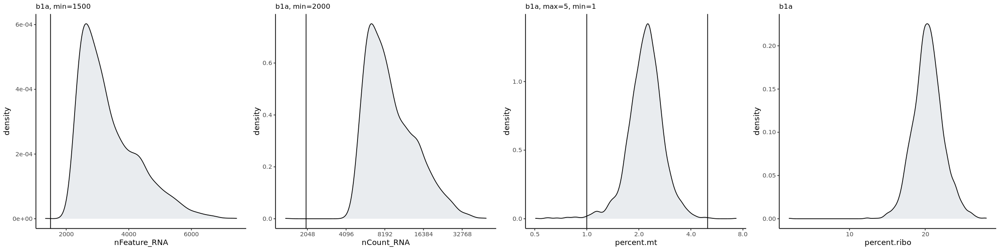

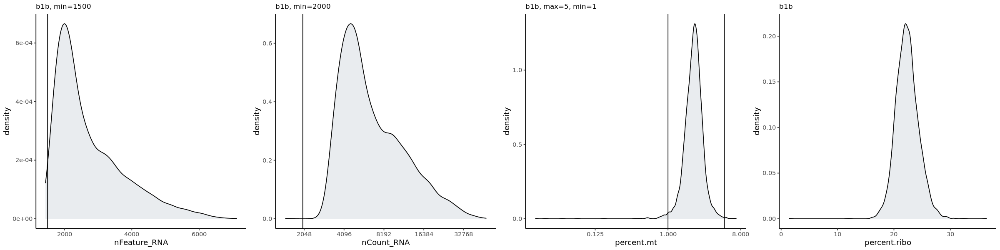

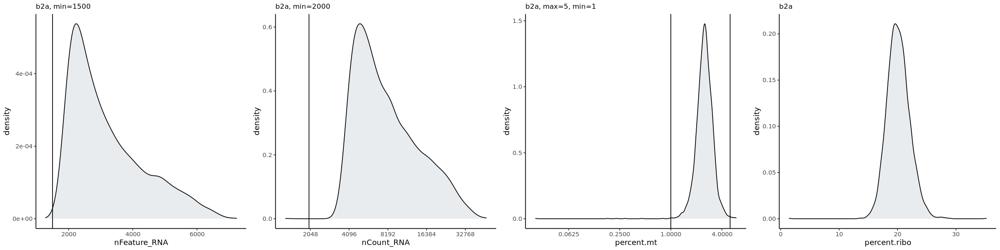

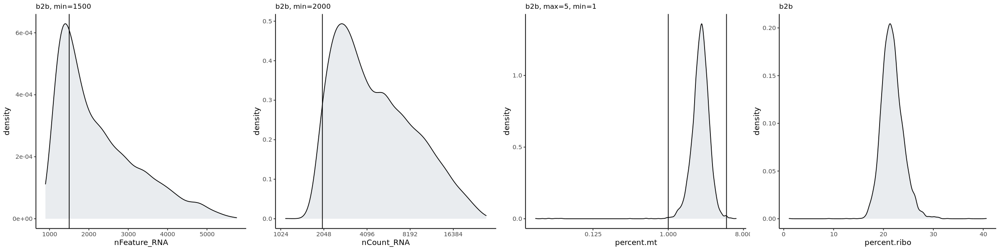

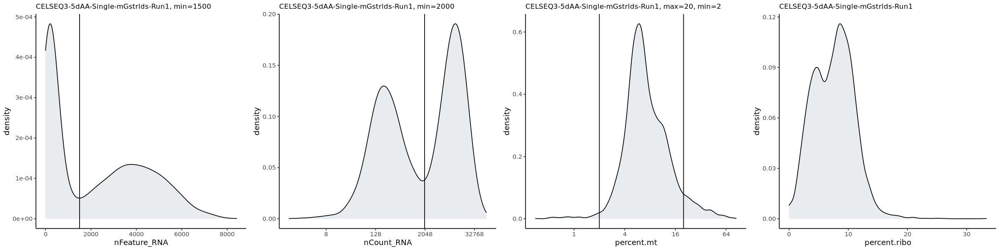

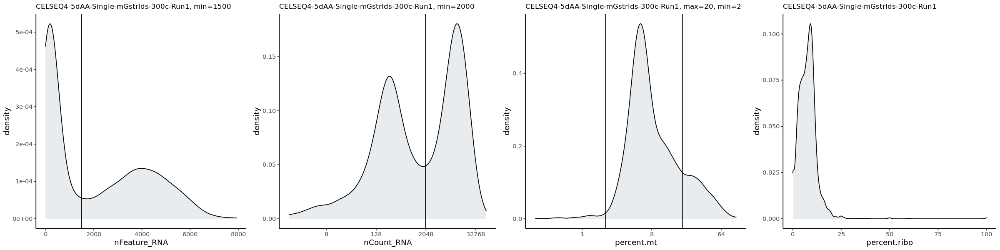

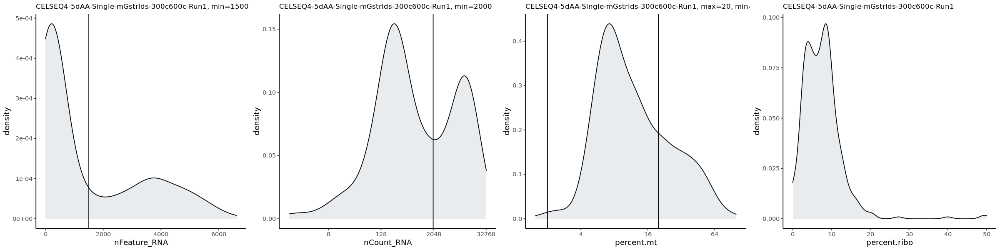

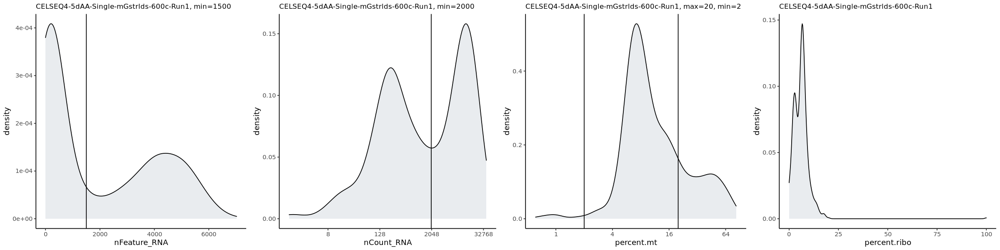

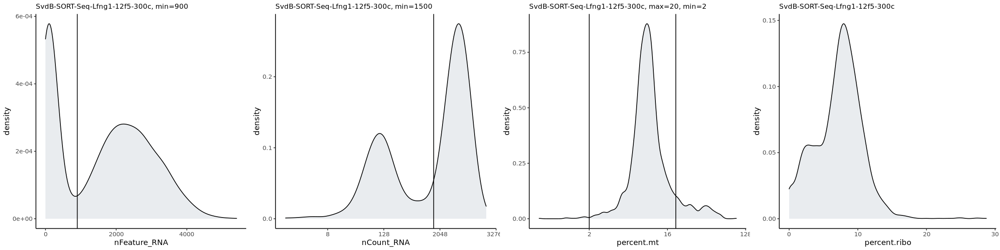

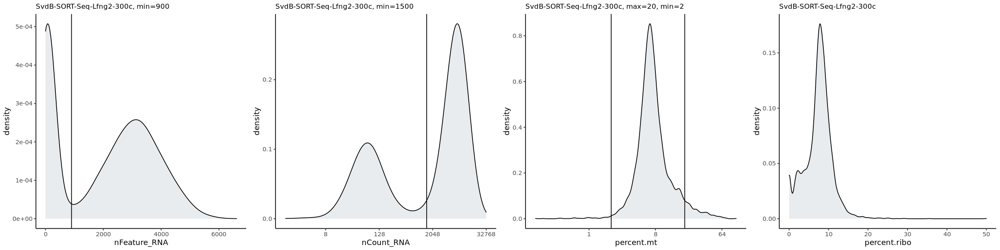

In [10]:
options(repr.plot.width=20, repr.plot.height=5)
options(warn=-1)

io <- list()
io$min_nFeature_RNA <- c('10x' = 1500,
                         'IB10_sort' = 1500,
                         'Lfng_sort' = 900
                        )
io$min_nCount_RNA <- c('10x' = 2000,
                       'IB10_sort' = 2000,
                       'Lfng_sort' = 1500
                      )
io$max_percent.mt <- c('10x' = 5,
                       'IB10_sort' = 20,
                       'Lfng_sort' = 20
                      )
io$min_percent.mt <- c('10x' = 1,
                       'IB10_sort' = 2,
                       'Lfng_sort' = 2
                      )

for (b in unique(md$batch)) {
    
    bi <- strsplit(b,"_")[[1]] %>% .[length(.)]

    toplot <- md[batch==b]
    exp <- unique(toplot$experiment)[1]

    p1 <- (ggplot(toplot, aes(x=nFeature_RNA)) +
        geom_density(fill="#e9ecef", position = 'identity') +
        #scale_fill_manual(values=c("#69b3a2")) +
        labs(fill="") +
        geom_vline(xintercept=io$min_nFeature_RNA[[exp]]) +
        ggtitle(paste0(b, ", min=", io$min_nFeature_RNA[[exp]])) +
        theme_classic() +
        theme(plot.title = element_text(size = 10)))

    p2 <- (ggplot(toplot, aes(x=nCount_RNA)) +
        geom_density(fill="#e9ecef", position = 'identity') +
        labs(fill="") +
        scale_x_continuous(trans='log2') +
        geom_vline(xintercept=io$min_nCount_RNA[[exp]]) +
        ggtitle(paste0(b, ", min=", io$min_nCount_RNA[[exp]])) +
        theme_classic() +
        theme(plot.title = element_text(size = 10)))

    p3 <- (ggplot(toplot, aes(x=percent.mt)) +
        geom_density(fill="#e9ecef", position = 'identity') +
        labs(fill="") +
        scale_x_continuous(trans='log2') +
        geom_vline(xintercept=io$max_percent.mt[[exp]]) +
        geom_vline(xintercept=io$min_percent.mt[[exp]]) +
        ggtitle(paste0(b, ", max=", io$max_percent.mt[[exp]], ", min=", io$min_percent.mt[[exp]])) +
        theme_classic() +
        theme(plot.title = element_text(size = 10)))

    p4 <- (ggplot(toplot, aes(x=percent.ribo)) +
        geom_density(fill="#e9ecef", position = 'identity') +
        labs(fill="") +
        ggtitle(b) +
        theme_classic() +
        theme(plot.title = element_text(size = 10)))

    grid.arrange(p1, p2, p3, p4, ncol=4)

}
options(warn=0)

Warning message:
“Transformation introduced infinite values in discrete y-axis”
Warning message:
“Removed 7959 rows containing missing values (geom_point).”
Warning message:
“Removed 7959 rows containing missing values (geom_point).”


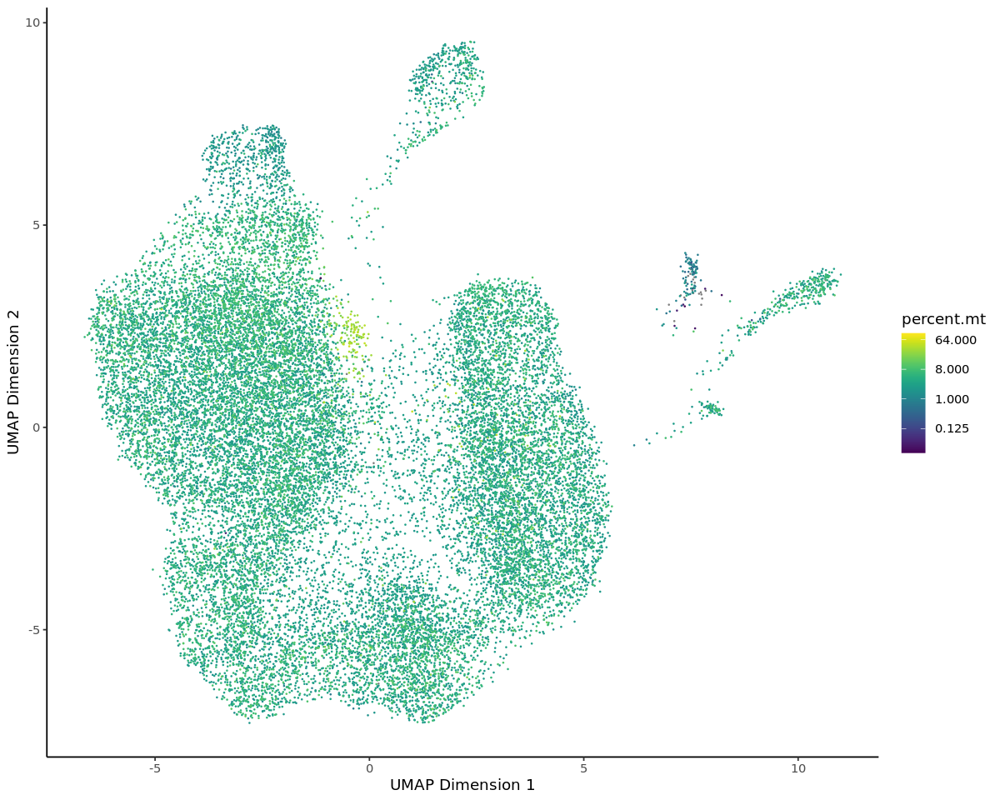

Warning message:
“Transformation introduced infinite values in discrete y-axis”
Warning message:
“Removed 7959 rows containing missing values (geom_point).”


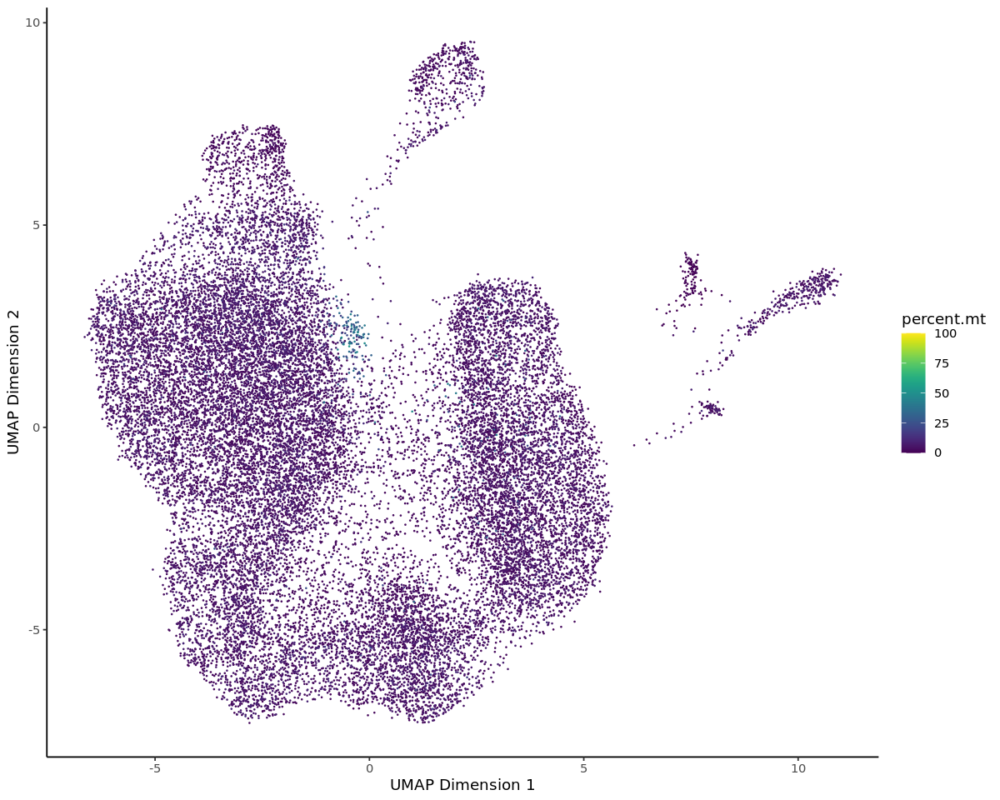

Warning message:
“Removed 7959 rows containing missing values (geom_point).”


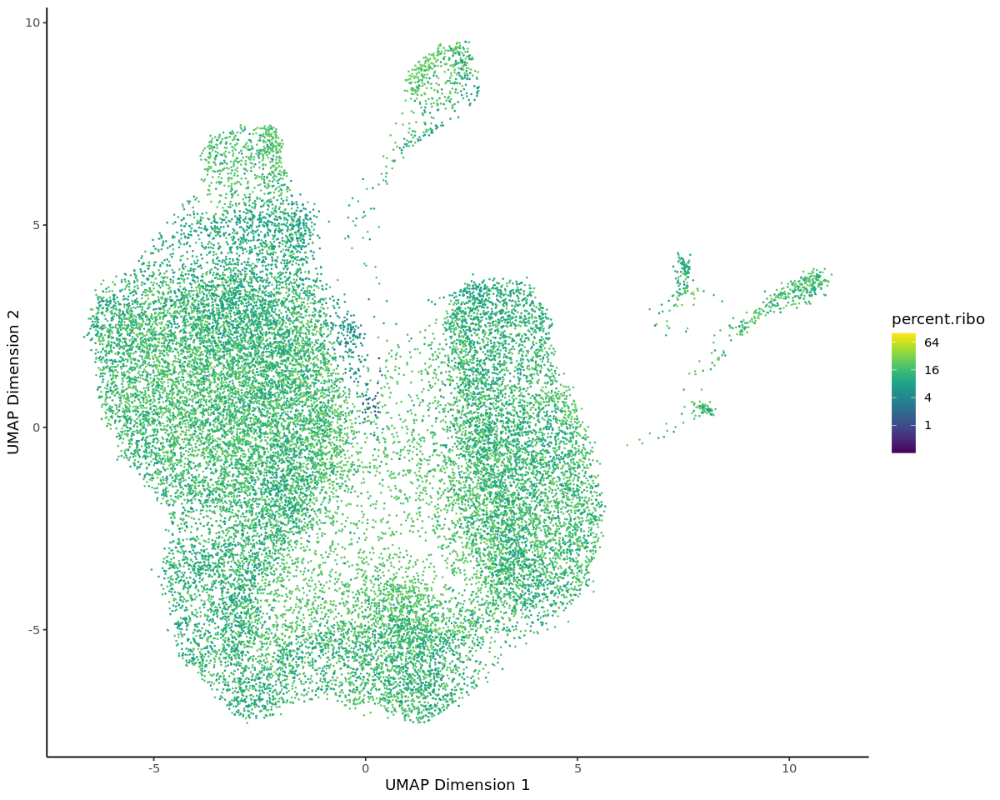

Warning message:
“Transformation introduced infinite values in discrete y-axis”
Warning message:
“Removed 7959 rows containing missing values (geom_point).”


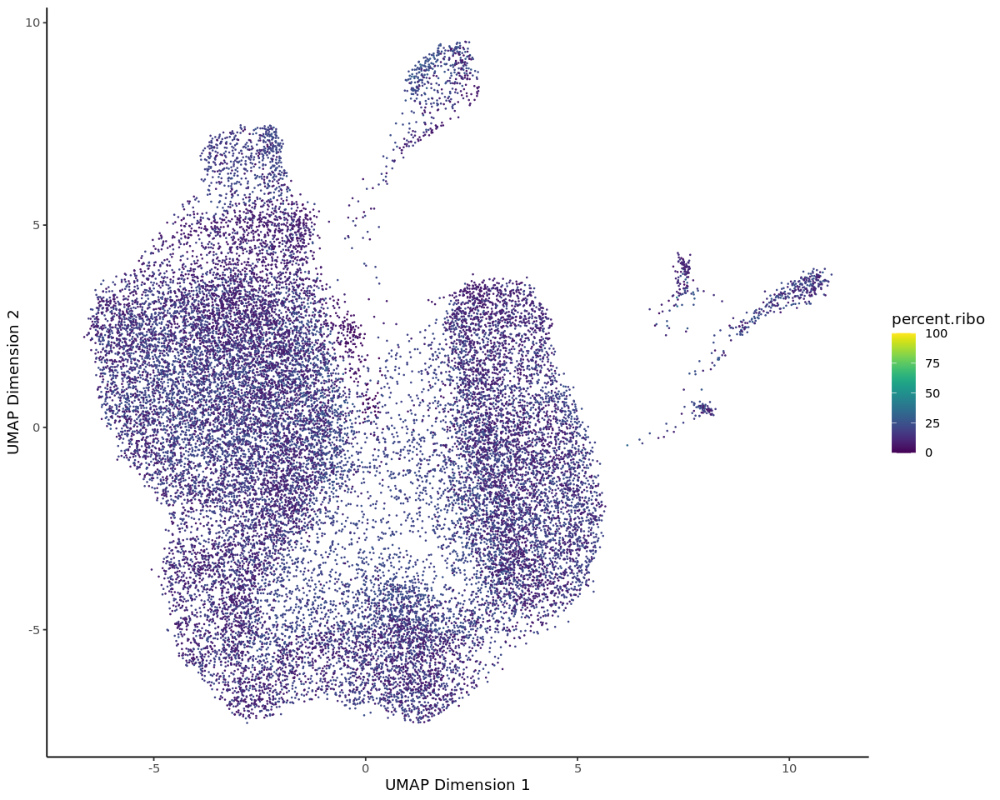

Warning message:
“Removed 7959 rows containing missing values (geom_point).”


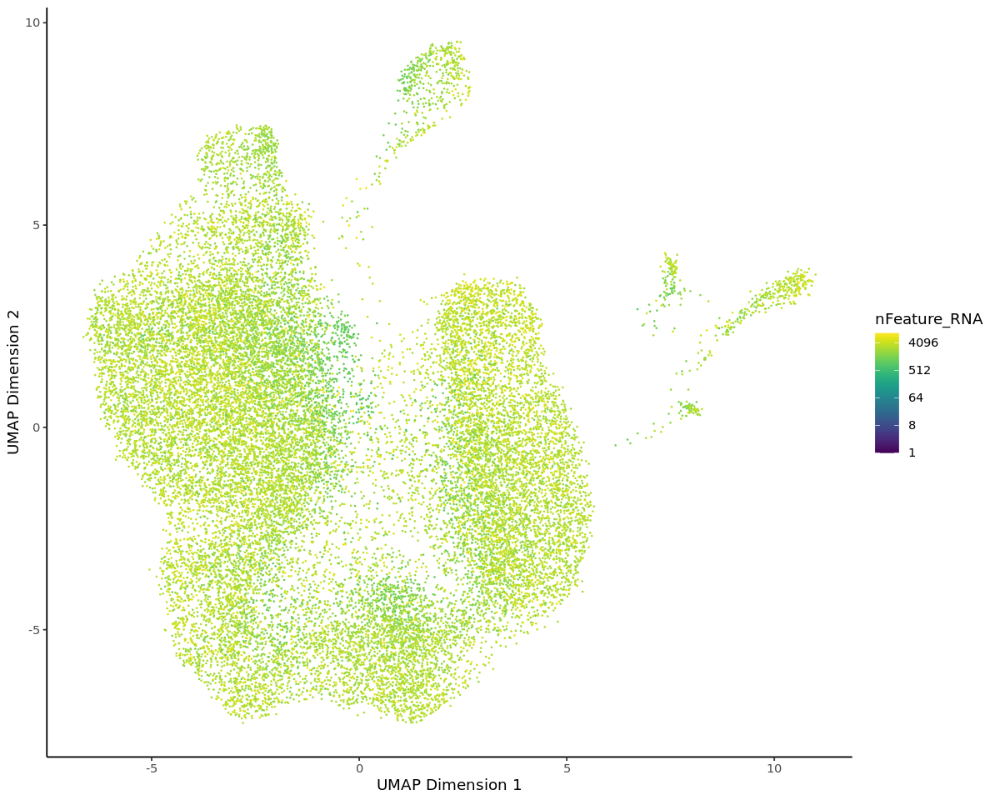

Warning message:
“Transformation introduced infinite values in discrete y-axis”
Warning message:
“Removed 7959 rows containing missing values (geom_point).”


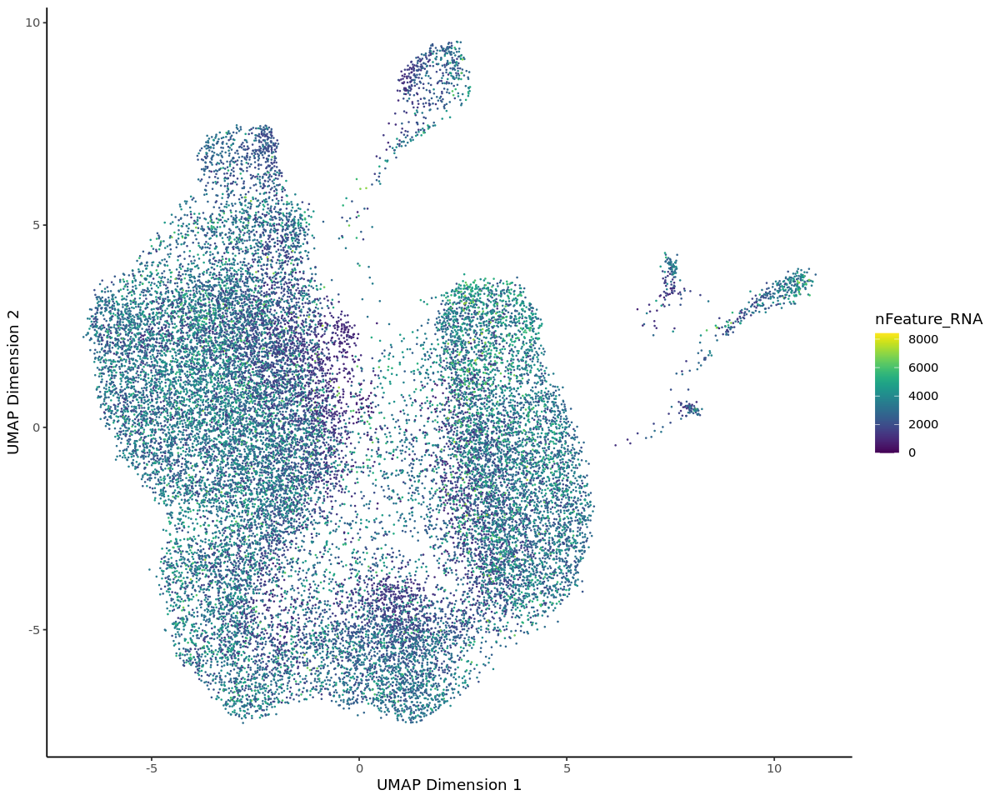

Warning message:
“Removed 7959 rows containing missing values (geom_point).”


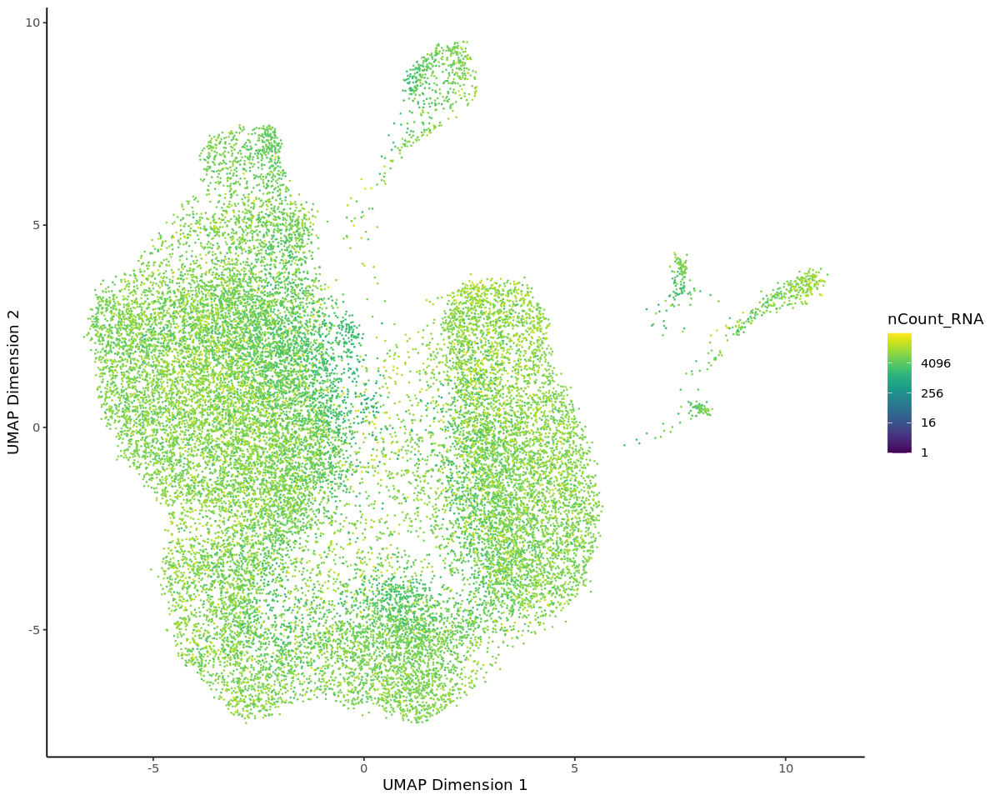

Warning message:
“Removed 7959 rows containing missing values (geom_point).”


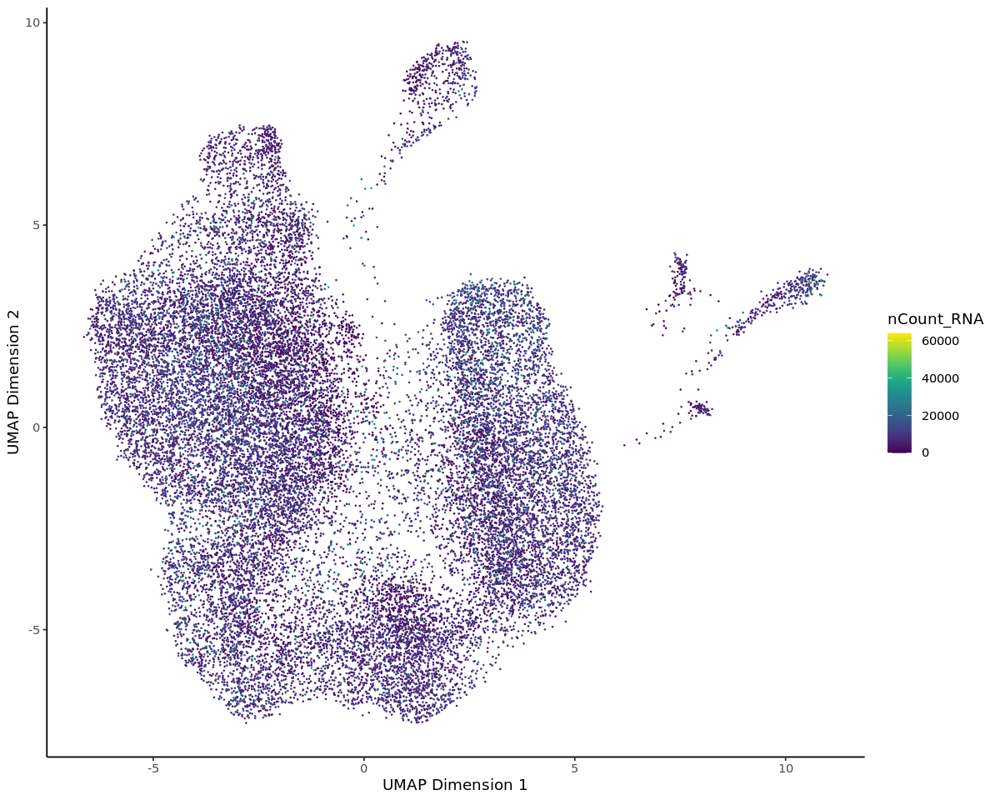

Warning message:
“Removed 7959 rows containing missing values (geom_point).”


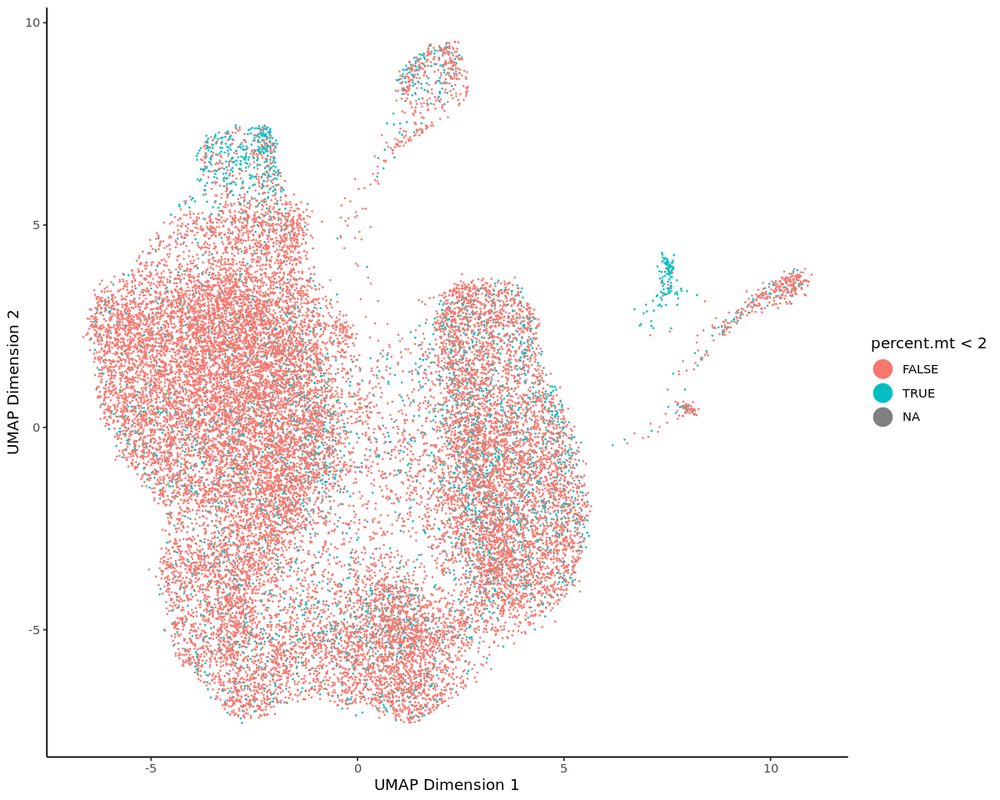

Warning message:
“Removed 7959 rows containing missing values (geom_point).”


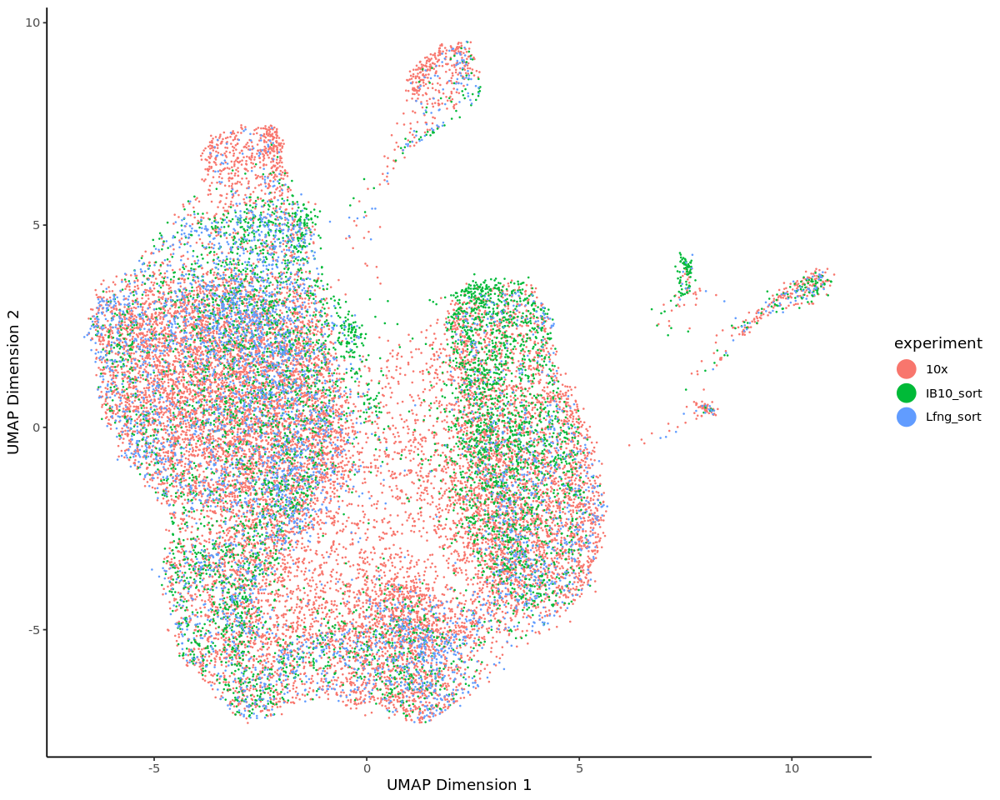

Warning message:
“Removed 7959 rows containing missing values (geom_point).”


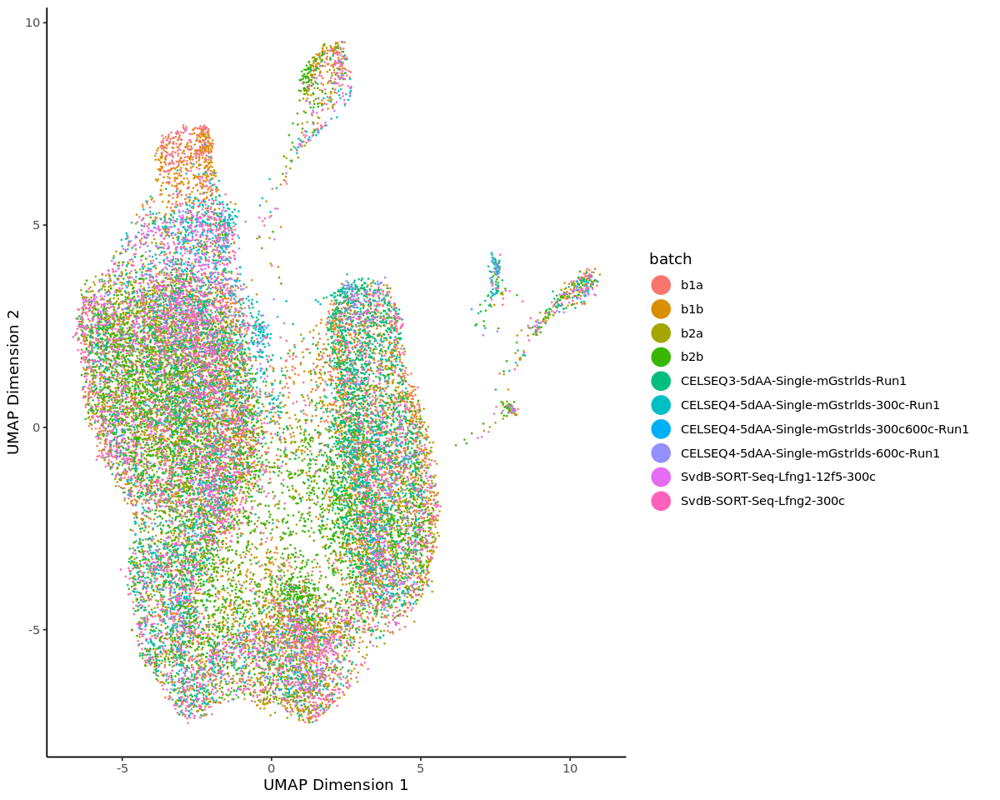

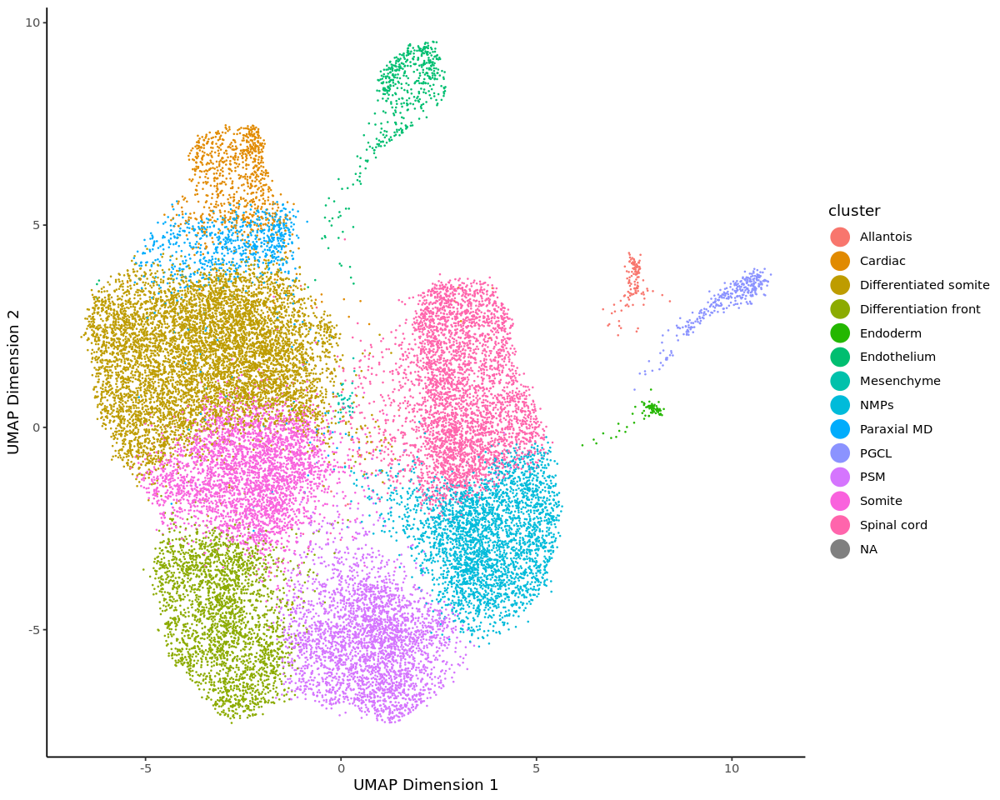

In [11]:
options(repr.plot.width=10, repr.plot.height=8)
p <- ggplot(data=md, mapping = aes(x=u1, y=u2, colour=percent.mt)) +
  geom_point(size=0.1, alpha=1) +
  # ggrastr::geom_point_rast(size=opts$dot_size, alpha=opts$dot_alpha) +
  labs(x="UMAP Dimension 1", y="UMAP Dimension 2") +
  scale_colour_viridis(trans='log2') +
  theme_classic()
print(p)
p <- ggplot(data=md, mapping = aes(x=u1, y=u2, colour=percent.mt)) +
  geom_point(size=0.1, alpha=1) +
  # ggrastr::geom_point_rast(size=opts$dot_size, alpha=opts$dot_alpha) +
  labs(x="UMAP Dimension 1", y="UMAP Dimension 2") +
  scale_colour_viridis() +
  theme_classic()
print(p)
p <- ggplot(data=md, mapping = aes(x=u1, y=u2, colour=percent.ribo)) +
  geom_point(size=0.1, alpha=1) +
  # ggrastr::geom_point_rast(size=opts$dot_size, alpha=opts$dot_alpha) +
  labs(x="UMAP Dimension 1", y="UMAP Dimension 2") +
  scale_colour_viridis(trans='log2') +
  theme_classic()
print(p)
p <- ggplot(data=md, mapping = aes(x=u1, y=u2, colour=percent.ribo)) +
  geom_point(size=0.1, alpha=1) +
  # ggrastr::geom_point_rast(size=opts$dot_size, alpha=opts$dot_alpha) +
  labs(x="UMAP Dimension 1", y="UMAP Dimension 2") +
  scale_colour_viridis() +
  theme_classic()
print(p)
p <- ggplot(data=md, mapping = aes(x=u1, y=u2, colour=nFeature_RNA)) +
  geom_point(size=0.1, alpha=1) +
  # ggrastr::geom_point_rast(size=opts$dot_size, alpha=opts$dot_alpha) +
  labs(x="UMAP Dimension 1", y="UMAP Dimension 2") +
  scale_colour_viridis(trans='log2') +
  theme_classic()
print(p)
p <- ggplot(data=md, mapping = aes(x=u1, y=u2, colour=nFeature_RNA)) +
  geom_point(size=0.1, alpha=1) +
  # ggrastr::geom_point_rast(size=opts$dot_size, alpha=opts$dot_alpha) +
  labs(x="UMAP Dimension 1", y="UMAP Dimension 2") +
  scale_colour_viridis() +
  theme_classic()
print(p)
p <- ggplot(data=md, mapping = aes(x=u1, y=u2, colour=nCount_RNA)) +
  geom_point(size=0.1, alpha=1) +
  # ggrastr::geom_point_rast(size=opts$dot_size, alpha=opts$dot_alpha) +
  labs(x="UMAP Dimension 1", y="UMAP Dimension 2") +
  scale_colour_viridis(trans='log2') +
  theme_classic()
print(p)
p <- ggplot(data=md, mapping = aes(x=u1, y=u2, colour=nCount_RNA)) +
  geom_point(size=0.1, alpha=1) +
  # ggrastr::geom_point_rast(size=opts$dot_size, alpha=opts$dot_alpha) +
  labs(x="UMAP Dimension 1", y="UMAP Dimension 2") +
  scale_colour_viridis() +
  theme_classic()
print(p)
p <- ggplot(data=md, mapping = aes(x=u1, y=u2, colour=percent.mt<2)) +
  geom_point(size=0.1, alpha=1) +
  # ggrastr::geom_point_rast(size=opts$dot_size, alpha=opts$dot_alpha) +
  labs(x="UMAP Dimension 1", y="UMAP Dimension 2") +
  guides(colour = guide_legend(override.aes = list(size=6))) +
  theme_classic()
print(p)
p <- ggplot(data=md, mapping = aes(x=u1, y=u2, colour=experiment)) +
  geom_point(size=0.1, alpha=1) +
  # ggrastr::geom_point_rast(size=opts$dot_size, alpha=opts$dot_alpha) +
  labs(x="UMAP Dimension 1", y="UMAP Dimension 2") +
  guides(colour = guide_legend(override.aes = list(size=6))) +
  theme_classic()
print(p)
p <- ggplot(data=md, mapping = aes(x=u1, y=u2, colour=batch)) +
  geom_point(size=0.1, alpha=1) +
  # ggrastr::geom_point_rast(size=opts$dot_size, alpha=opts$dot_alpha) +
  labs(x="UMAP Dimension 1", y="UMAP Dimension 2") +
  guides(colour = guide_legend(override.aes = list(size=6))) +
  theme_classic()
print(p)
p <- ggplot(data=md, mapping = aes(x=u1, y=u2, colour=cluster)) +
  geom_point(size=0.1, alpha=1) +
  # ggrastr::geom_point_rast(size=opts$dot_size, alpha=opts$dot_alpha) +
  labs(x="UMAP Dimension 1", y="UMAP Dimension 2") +
  guides(colour = guide_legend(override.aes = list(size=6))) +
  theme_classic()
print(p)

In [12]:
io$s.genes.ensid <- '/nfs/research/marioni/Leah/data/cell_cycle_genes/s_genes_ENS.txt'
io$g2m.genes.ensid <- '/nfs/research/marioni/Leah/data/cell_cycle_genes/g2m_genes_ENS.txt'
io$k <- 30
io$npcs <- 50

In [13]:
srat_vdbrink_list <- SplitObject(srat_vdbrink, split.by = "batch")
md_list <- list()
for (b in unique(md$batch)) {
    
    exp <- unique(md[batch==b]$experiment)[1]
    
    srat_vdbrink_list[[b]] <- subset(srat_vdbrink_list[[b]],
                                     subset = (percent.mt>io$min_percent.mt[[exp]]) &
                                              (percent.mt<io$max_percent.mt[[exp]]) &
                                              (nCount_RNA>io$min_nCount_RNA[[exp]]) &
                                              (nFeature_RNA>io$min_nFeature_RNA[[exp]])
                                    )
    
    sce_tmp <- as.SingleCellExperiment(srat_vdbrink_list[[b]])
    sce_tmp <- cxds_bcds_hybrid(sce_tmp, estNdbl=TRUE)
    md_list[[b]] <- merge(as.data.table(md[batch==b]), as.data.table(colData(sce_tmp))[,c("cell", "cxds_score", "cxds_call", "bcds_score", "bcds_call", "hybrid_score", "hybrid_call")], all.x=TRUE, by="cell")
    md_list[[b]][,pass_QC := FALSE]
    md_list[[b]][cell %in% Cells(srat_vdbrink_list[[b]]), pass_QC := TRUE]
    rownames(md_list[[b]]) <- md_list[[b]]$cell
    srat_vdbrink_list[[b]]@meta.data <- md_list[[b]][pass_QC==TRUE]
    rownames(srat_vdbrink_list[[b]]@meta.data) <- srat_vdbrink_list[[b]]@meta.data$cell

    srat_vdbrink_list[[b]] <- NormalizeData(srat_vdbrink_list[[b]])
    srat_vdbrink_list[[b]] <- FindVariableFeatures(srat_vdbrink_list[[b]])
    srat_vdbrink_list[[b]]@assays$RNA@scale.data <- as.matrix(srat_vdbrink_list[[b]]@assays$RNA@data)
    srat_vdbrink_list[[b]] <- RunPCA(srat_vdbrink_list[[b]], verbose=FALSE)
    srat_vdbrink_list[[b]] <- FindNeighbors(srat_vdbrink_list[[b]], k.param=io$k, reduction = "pca")
    rownames(srat_vdbrink_list[[b]]@meta.data) <- srat_vdbrink_list[[b]]@meta.data$cell
    srat_vdbrink_list[[b]] <- CellCycleScoring(srat_vdbrink_list[[b]],
                                             s.features = fread(io$s.genes.ensid, header = FALSE)$V1,
                                             g2m.features = fread(io$g2m.genes.ensid, header = FALSE)$V1,
                                             set.ident = FALSE
                                            )

    tmp <- data.table(hybrid_map = rowSums(srat_vdbrink_list[[b]]@graphs$RNA_nn[,md_list[[b]][hybrid_call==TRUE]$cell])/io$k,
                      cell = rownames(srat_vdbrink_list[[b]]@graphs$RNA_snn))
    md_list[[b]] <- merge(md_list[[b]], tmp, by = "cell", all.x=TRUE)
    md_list[[b]][hybrid_call==TRUE, hybrid_map := NA]
    md_list[[b]][,hybrid_call2 := TRUE]
    md_list[[b]][hybrid_map<=((sum(md_list[[b]][pass_QC==TRUE]$hybrid_call==TRUE))/(dim(md_list[[b]][pass_QC==TRUE])[1])), hybrid_call2 := FALSE]
    md_list[[b]][pass_QC==FALSE, hybrid_call2 := NA]
    rownames(md_list[[b]]) <- md_list[[b]]$cell

    md_list[[b]] <- merge(md_list[[b]], srat_vdbrink_list[[b]]@meta.data[,c("cell", "S.Score", "G2M.Score", "Phase")], by="cell", all.x=TRUE)
    rownames(md_list[[b]]) <- md_list[[b]]$cell
}
md <- rbindlist(md_list)
rownames(md) <- md$cell
srat_vdbrink@meta.data <- md

Setting levels: control = 0, case = 1

Setting direction: controls < cases

Setting levels: control = 0, case = 1

Setting direction: controls < cases

Setting levels: control = 0, case = 1

Setting direction: controls < cases

Computing nearest neighbor graph

Computing SNN

Setting levels: control = 0, case = 1

Setting direction: controls < cases

Setting levels: control = 0, case = 1

Setting direction: controls < cases

Setting levels: control = 0, case = 1

Setting direction: controls < cases

Computing nearest neighbor graph

Computing SNN

Setting levels: control = 0, case = 1

Setting direction: controls < cases

Setting levels: control = 0, case = 1

Setting direction: controls < cases

Setting levels: control = 0, case = 1

Setting direction: controls < cases

Computing nearest neighbor graph

Computing SNN

Setting levels: control = 0, case = 1

Setting direction: controls < cases

Setting levels: control = 0, case = 1

Setting direction: controls < cases

Setting levels: c

Warning message:
“Removed 7959 rows containing missing values (geom_point).”
Warning message:
“Removed 7959 rows containing missing values (geom_point).”


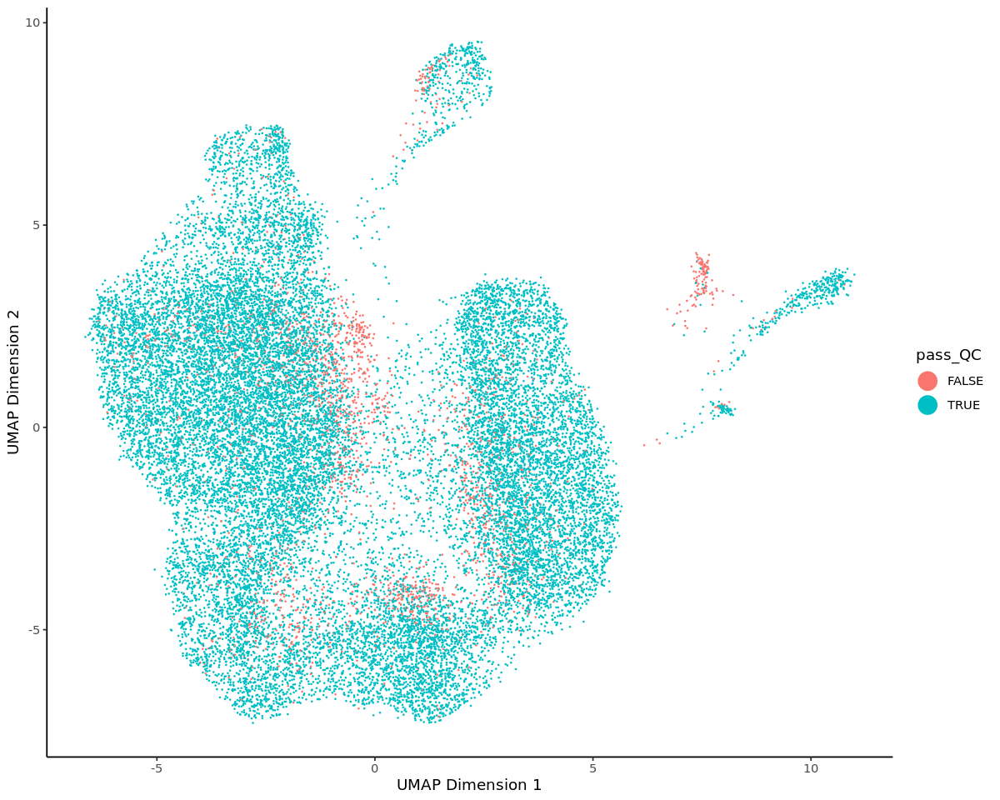

Warning message:
“Removed 7959 rows containing missing values (geom_point).”


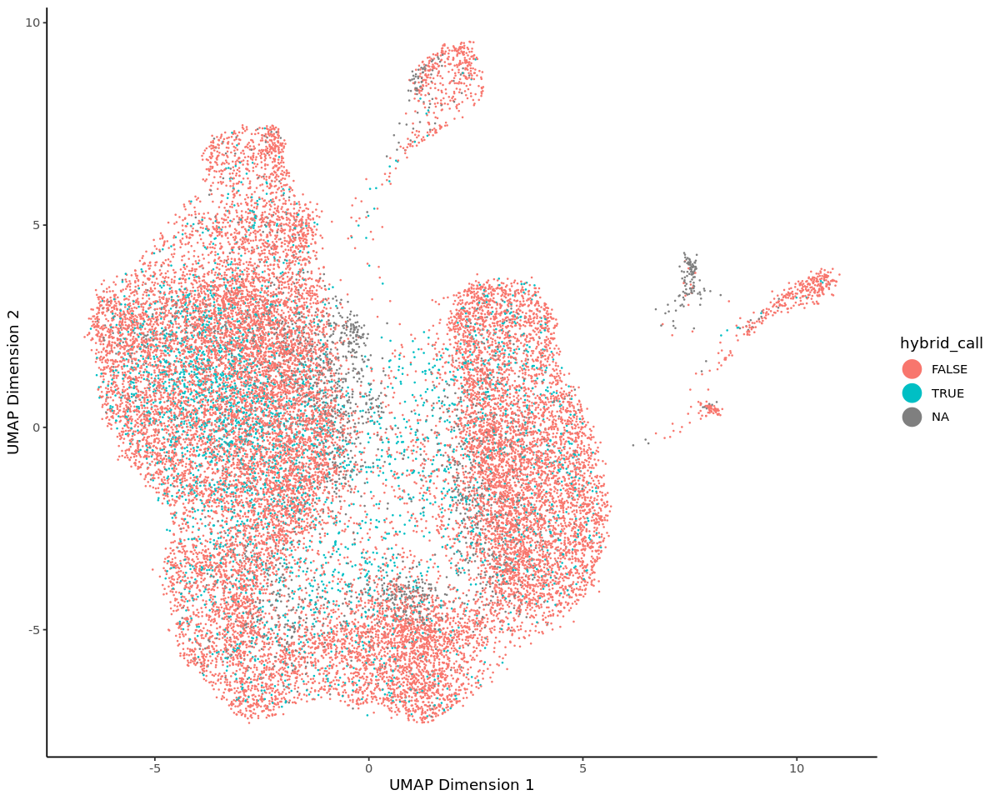

Warning message:
“Removed 7959 rows containing missing values (geom_point).”


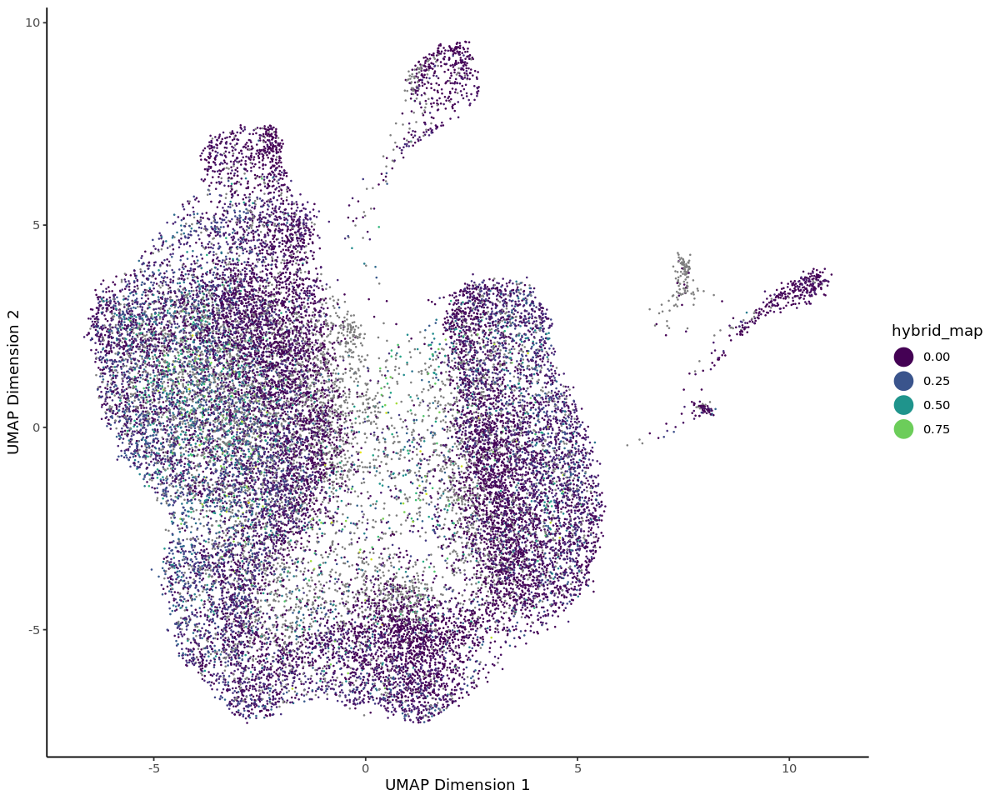

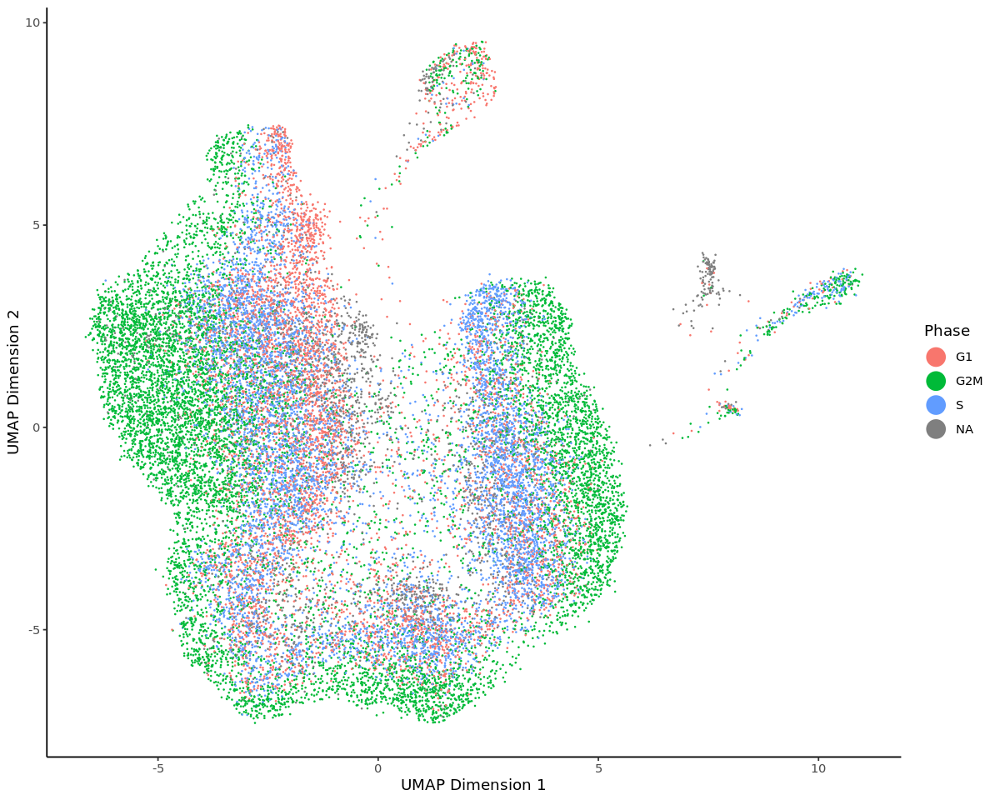

In [14]:
options(repr.plot.width=10, repr.plot.height=8)
p <- ggplot(data=md, mapping = aes(x=u1, y=u2, colour=pass_QC)) +
  geom_point(size=0.1, alpha=1) +
  # ggrastr::geom_point_rast(size=opts$dot_size, alpha=opts$dot_alpha) +
  labs(x="UMAP Dimension 1", y="UMAP Dimension 2") +
  guides(colour = guide_legend(override.aes = list(size=6))) +
  theme_classic()
print(p)
p <- ggplot(data=md, mapping = aes(x=u1, y=u2, colour=hybrid_call)) +
  geom_point(size=0.1, alpha=1) +
  # ggrastr::geom_point_rast(size=opts$dot_size, alpha=opts$dot_alpha) +
  labs(x="UMAP Dimension 1", y="UMAP Dimension 2") +
  guides(colour = guide_legend(override.aes = list(size=6))) +
  theme_classic()
print(p)
p <- ggplot(data=md, mapping = aes(x=u1, y=u2, colour=hybrid_map)) +
  geom_point(size=0.1, alpha=1) +
  # ggrastr::geom_point_rast(size=opts$dot_size, alpha=opts$dot_alpha) +
  labs(x="UMAP Dimension 1", y="UMAP Dimension 2") +
  guides(colour = guide_legend(override.aes = list(size=6))) +
  scale_colour_viridis() +
  theme_classic()
print(p)
p <- ggplot(data=md, mapping = aes(x=u1, y=u2, colour=Phase)) +
  geom_point(size=0.1, alpha=1) +
  # ggrastr::geom_point_rast(size=opts$dot_size, alpha=opts$dot_alpha) +
  labs(x="UMAP Dimension 1", y="UMAP Dimension 2") +
  guides(colour = guide_legend(override.aes = list(size=6))) +
  theme_classic()
print(p)

Warning message:
“The default method for RunUMAP has changed from calling Python UMAP via reticulate to the R-native UWOT using the cosine metric
To use Python UMAP via reticulate, set umap.method to 'umap-learn' and metric to 'correlation'
This message will be shown once per session”


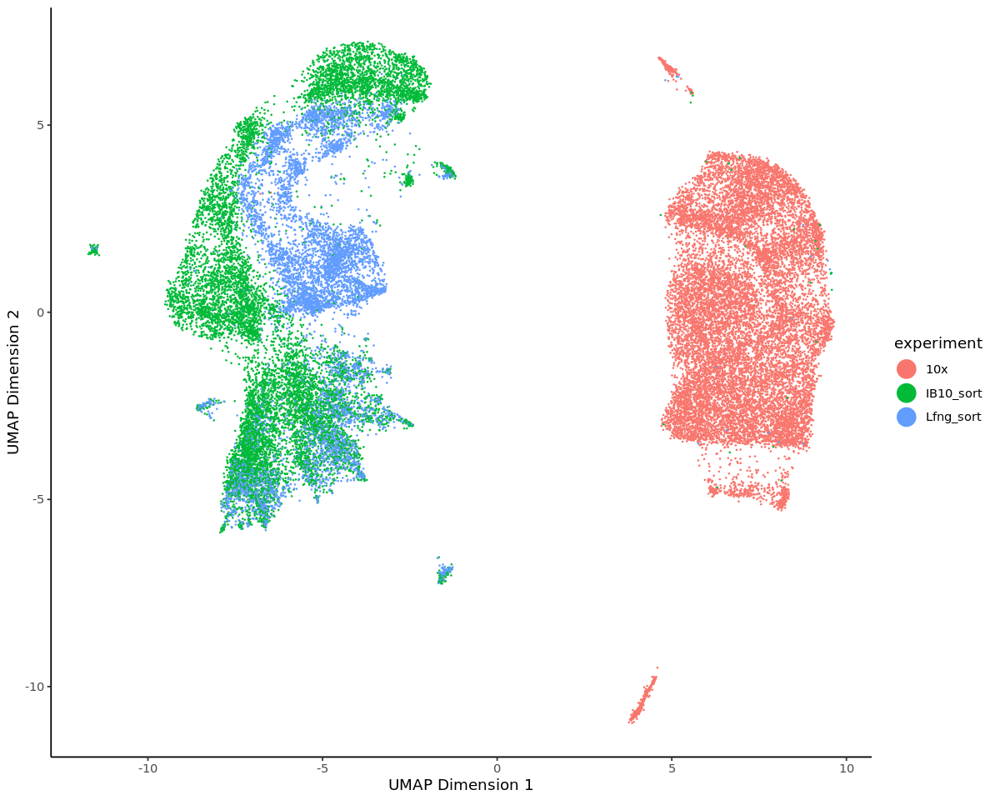

In [15]:
tmp <- NormalizeData(srat_vdbrink)
tmp <- FindVariableFeatures(tmp)
tmp@assays$RNA@scale.data <- as.matrix(tmp@assays$RNA@data)
tmp <- RunPCA(tmp, verbose=FALSE)
tmp <- RunUMAP(tmp, verbose=FALSE, dims = 1:50)
to.plot <- as.data.frame(tmp@reductions$umap@cell.embeddings)
to.plot$cell <- rownames(to.plot)
to.plot <- merge(md, to.plot, by="cell")
p <- ggplot(data=to.plot, mapping = aes(x=UMAP_1, y=UMAP_2, colour=experiment)) +
  geom_point(size=0.1, alpha=1) +
  # ggrastr::geom_point_rast(size=opts$dot_size, alpha=opts$dot_alpha) +
  labs(x="UMAP Dimension 1", y="UMAP Dimension 2") +
  guides(colour = guide_legend(override.aes = list(size=6))) +
  theme_classic()
print(p)

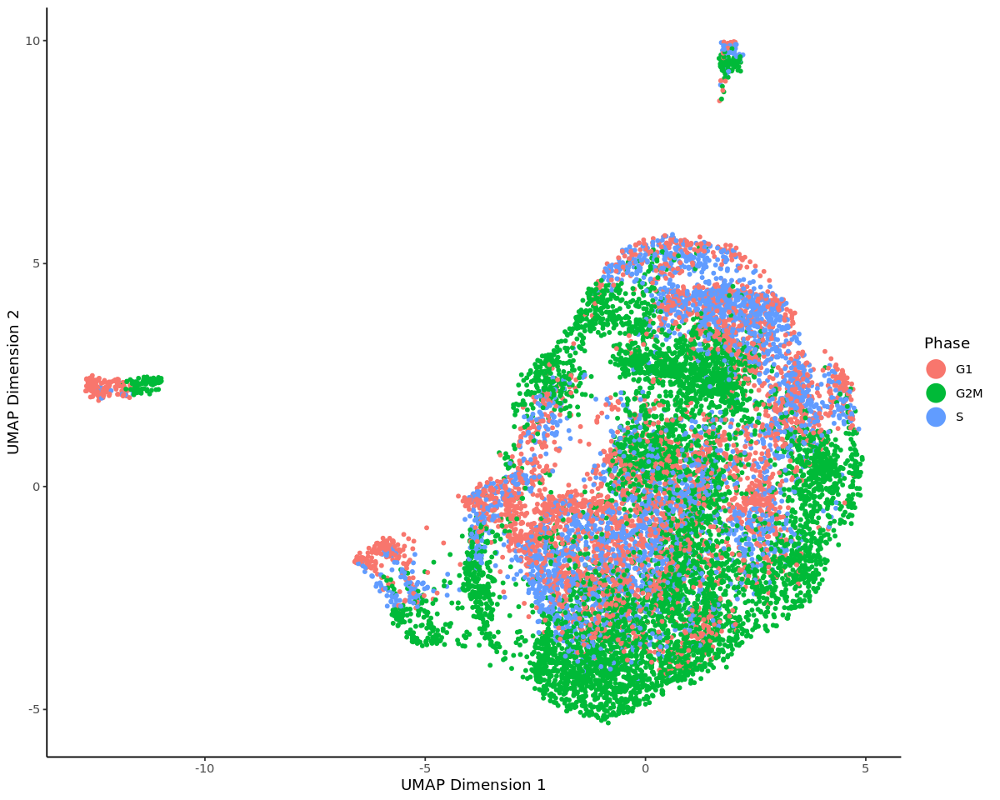

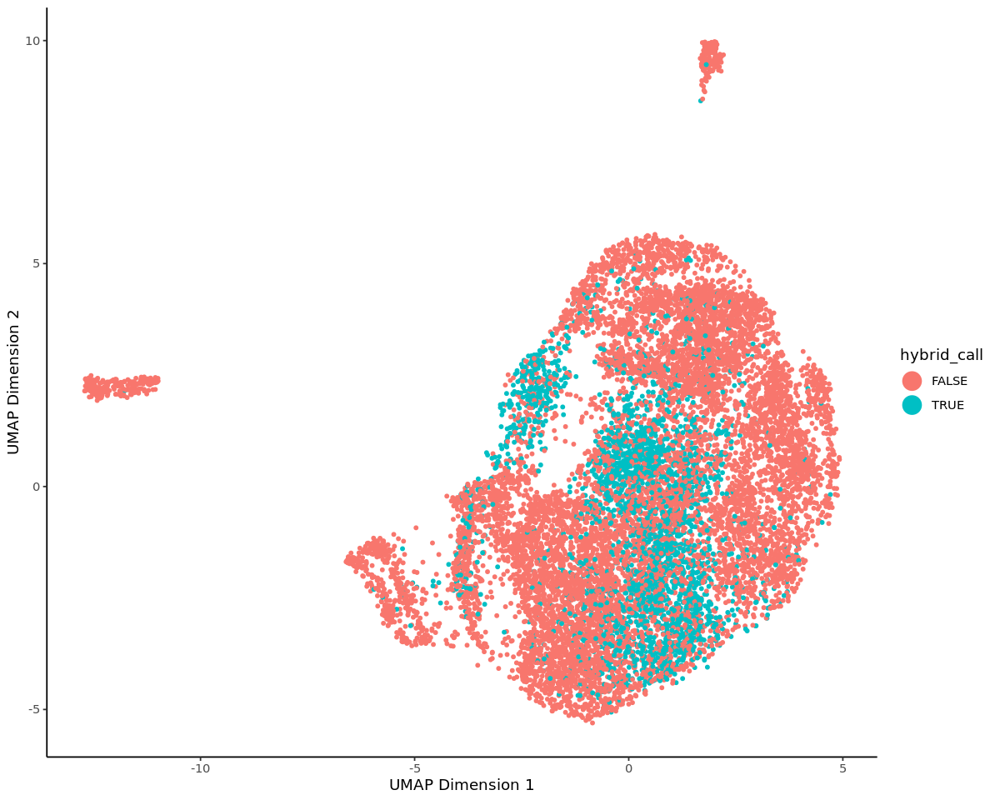

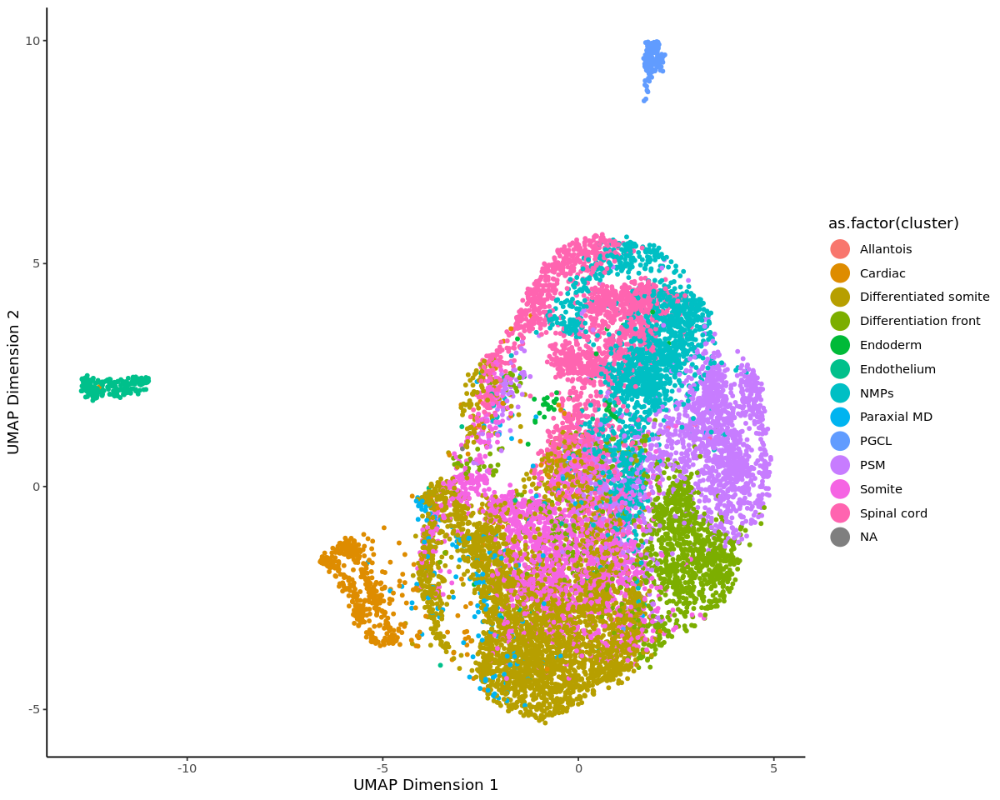

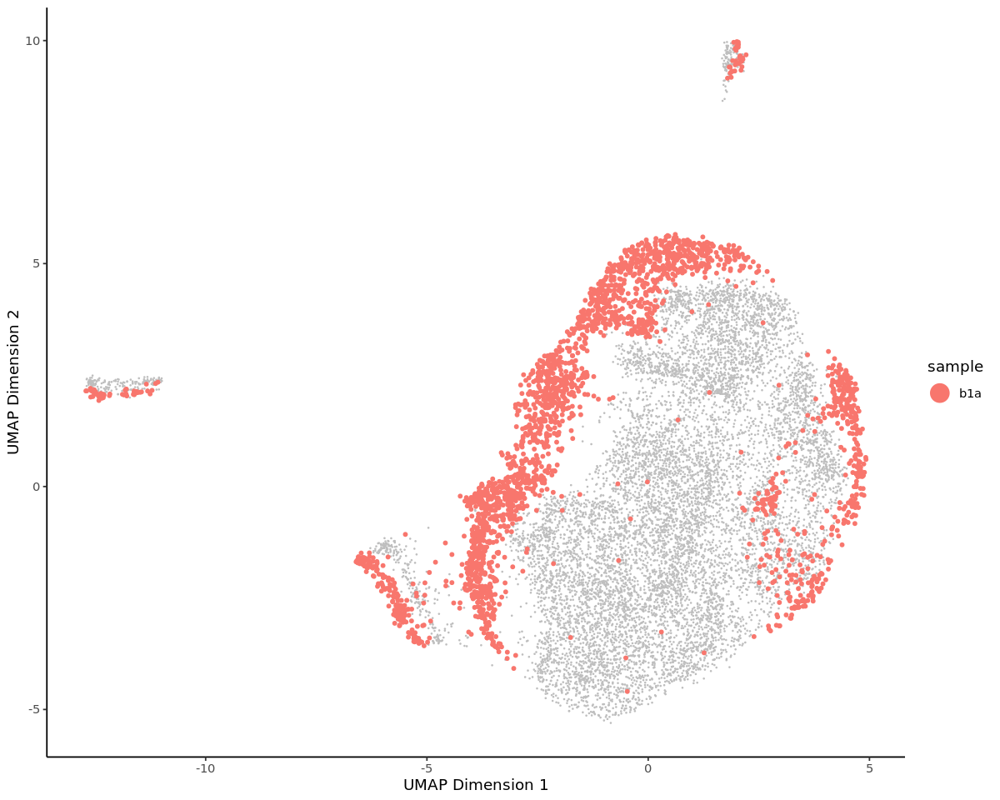

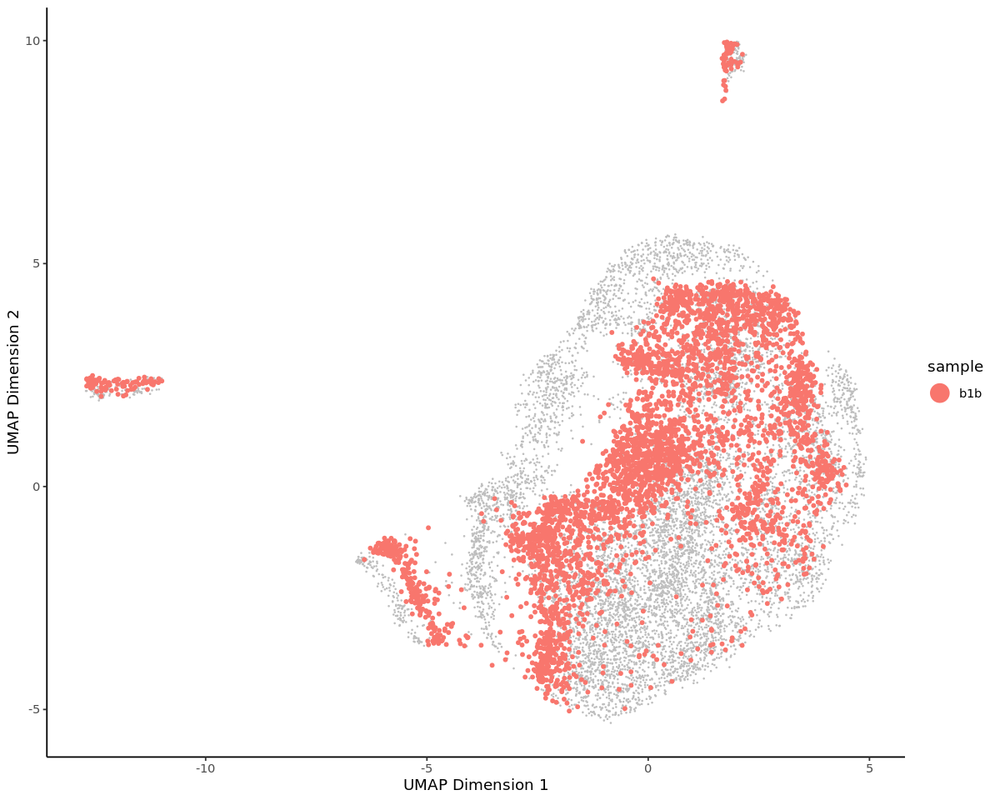

...

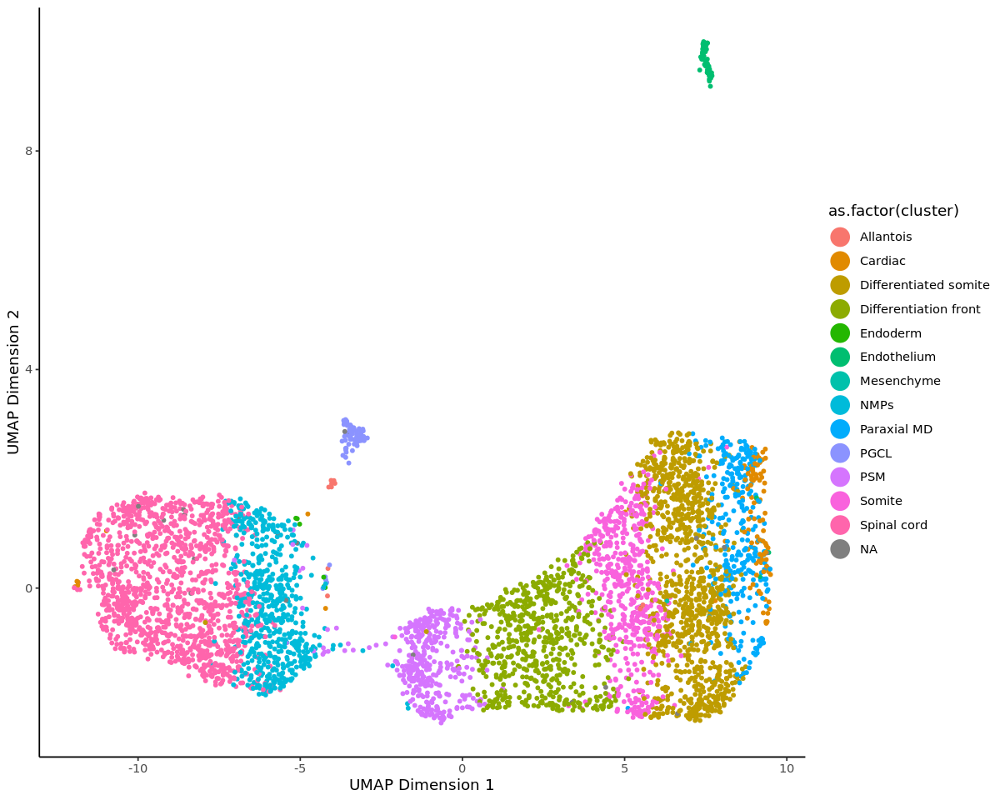

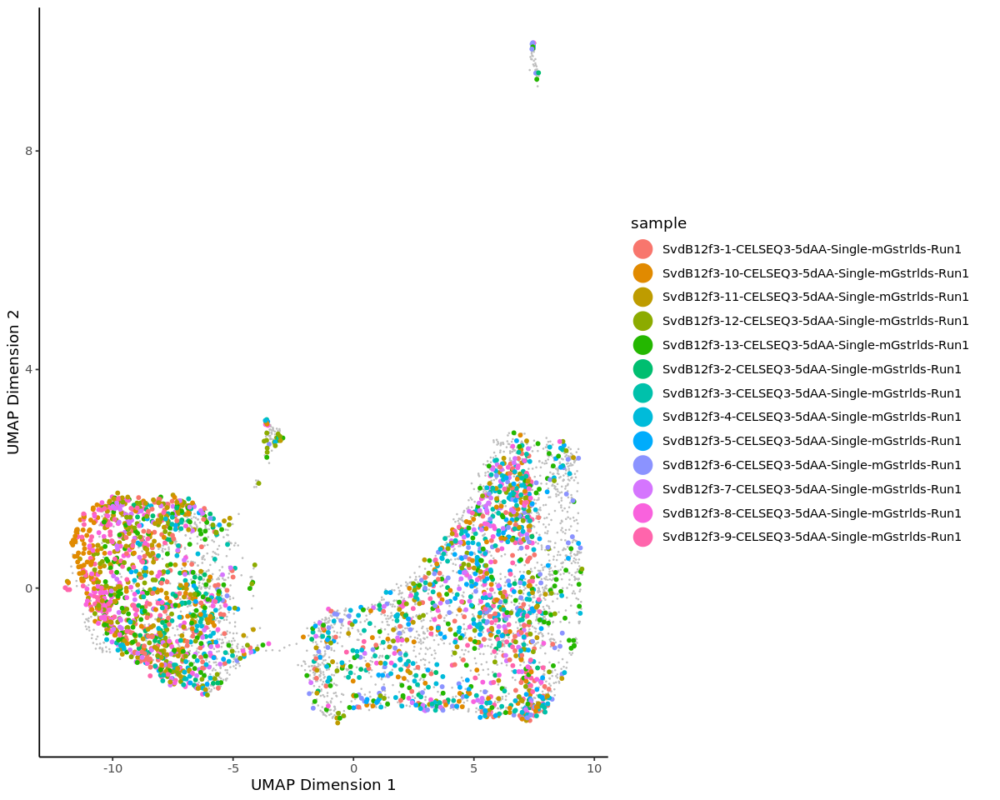

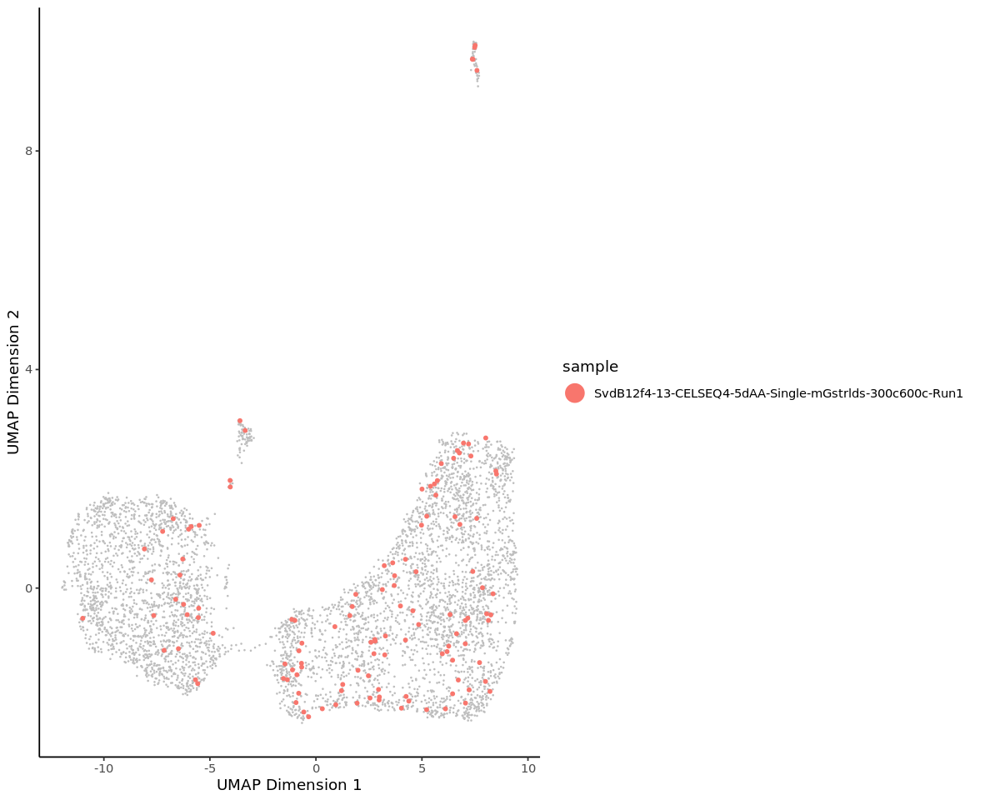

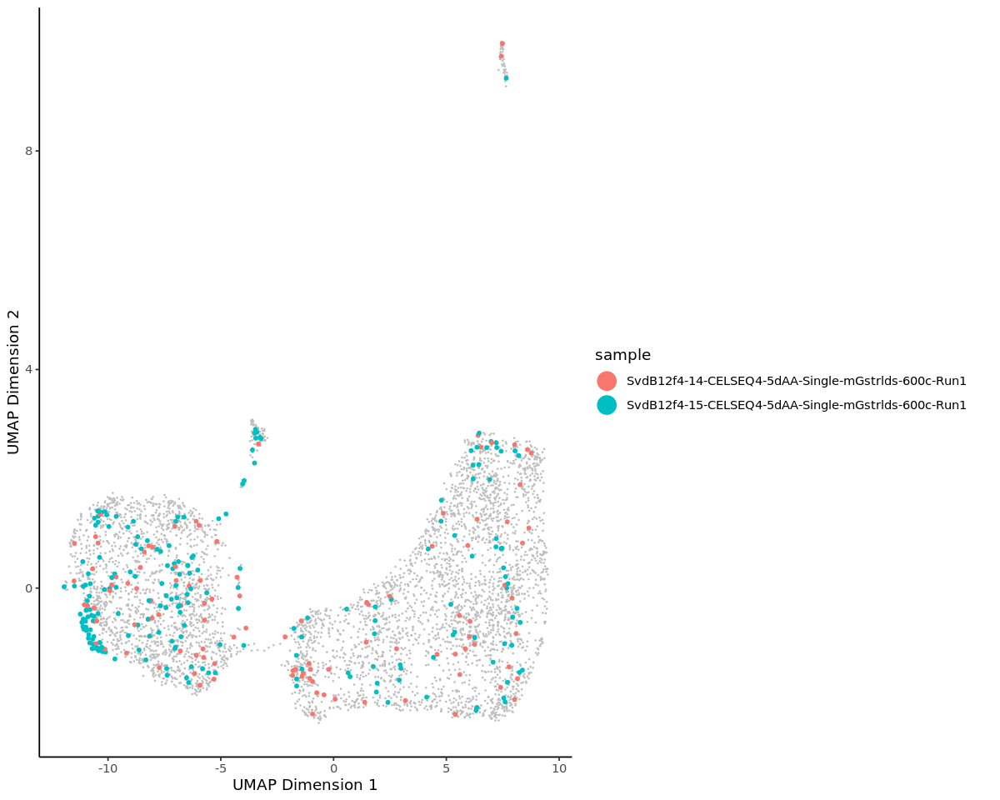

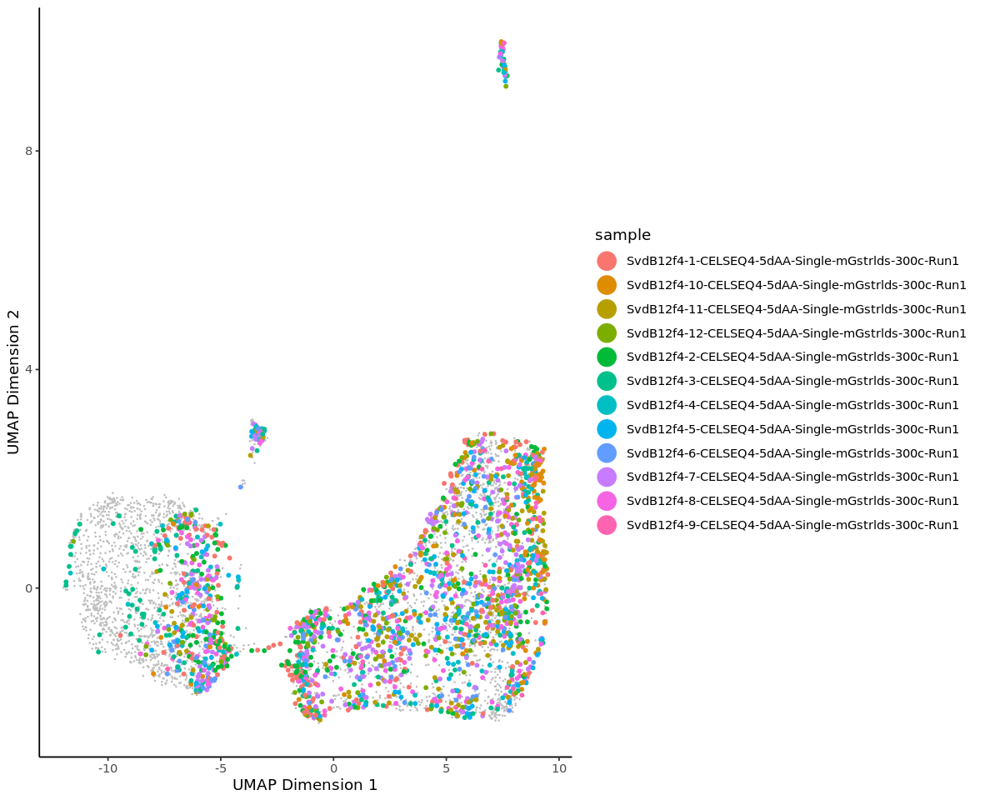

In [16]:
for (exp in unique(to.plot$experiment)) {
    tmp <- srat_vdbrink
    tmp@meta.data <- as.data.frame(tmp@meta.data)
    rownames(tmp@meta.data) <- tmp@meta.data$cell
    tmp <- NormalizeData(subset(tmp, subset=(experiment==exp) & (pass_QC==TRUE)))
    tmp <- FindVariableFeatures(tmp)
    tmp@assays$RNA@scale.data <- as.matrix(tmp@assays$RNA@data)
    tmp <- RunPCA(tmp, verbose=FALSE)
    tmp <- RunUMAP(tmp, verbose=FALSE, dims = 1:50)
    to.plot_sub <- as.data.frame(tmp@reductions$umap@cell.embeddings)
    to.plot_sub$cell <- rownames(to.plot_sub)
    to.plot_sub <- merge(md, to.plot_sub, by="cell", all.x=FALSE)
    p <- ggplot(data=to.plot_sub, mapping = aes(x=UMAP_1, y=UMAP_2, colour=Phase)) +
      geom_point(size=1, alpha=1) +
      # ggrastr::geom_point_rast(size=opts$dot_size, alpha=opts$dot_alpha) +
      labs(x="UMAP Dimension 1", y="UMAP Dimension 2") +
      guides(colour = guide_legend(override.aes = list(size=6))) +
      theme_classic()
    print(p)
    p <- ggplot(data=to.plot_sub, mapping = aes(x=UMAP_1, y=UMAP_2, colour=hybrid_call)) +
      geom_point(size=1, alpha=1) +
      # ggrastr::geom_point_rast(size=opts$dot_size, alpha=opts$dot_alpha) +
      labs(x="UMAP Dimension 1", y="UMAP Dimension 2") +
      guides(colour = guide_legend(override.aes = list(size=6))) +
      theme_classic()
    print(p)
    p <- ggplot(data=to.plot_sub, mapping = aes(x=UMAP_1, y=UMAP_2, colour=as.factor(cluster))) +
      geom_point(size=1, alpha=1) +
      # ggrastr::geom_point_rast(size=opts$dot_size, alpha=opts$dot_alpha) +
      labs(x="UMAP Dimension 1", y="UMAP Dimension 2") +
      guides(colour = guide_legend(override.aes = list(size=6))) +
      theme_classic()
    print(p)
    for (b in unique(to.plot_sub$batch)) {
        p <- ggplot(data=to.plot_sub[batch==b], mapping = aes(x=UMAP_1, y=UMAP_2, colour=sample)) +
          geom_point(data=select(to.plot_sub,-batch), colour="grey", size=0.1, alpha=1) +
          geom_point(size=1, alpha=1) +
          # ggrastr::geom_point_rast(size=opts$dot_size, alpha=opts$dot_alpha) +
          labs(x="UMAP Dimension 1", y="UMAP Dimension 2") +
          guides(colour = guide_legend(override.aes = list(size=6))) +
          theme_classic()
        print(p)
    }
}

# Map to my gastruloids

In [17]:
suppressPackageStartupMessages(library(SingleCellExperiment))
suppressPackageStartupMessages(library(data.table))
suppressPackageStartupMessages(library(purrr))
suppressPackageStartupMessages(library(ggplot2))
suppressPackageStartupMessages(library(scran))
suppressPackageStartupMessages(library(batchelor))
suppressPackageStartupMessages(library(tools))
suppressPackageStartupMessages(library(stringr))
suppressPackageStartupMessages(library(umap))
suppressPackageStartupMessages(library(scuttle))

In [18]:
source('/nfs/research/marioni/Leah/gastrulation_epigenetics/gastruloid_characterisation/gastruloids_scRNAseq/pipeline/mapping/mapping_functions.R')

In [19]:
g_meta <- fread('/nfs/research/marioni/Leah/gastrulation_epigenetics/gastruloid_characterisation/data_dir/processed_files_Leah/scRNAseq/sample_metadata_final.txt.gz')
g_meta[MULTI_class %in% as.vector(unlist(neural)), gastr_type := "neural"]
g_meta[MULTI_class %in% as.vector(unlist(mesodermal)), gastr_type := "mesodermal"]
g_meta[MULTI_class %in% as.vector(unlist(intermediate)), gastr_type := "intermediate"]
g_srat <- readRDS("/nfs/research/marioni/Leah/gastrulation_epigenetics/gastruloid_characterisation/data_dir/processed_files_Leah/scRNAseq/seurat_final.rds")[,g_meta$cell]

g_meta$dataset <- 'Gastruloids'

In [20]:
run_correct <- function(srat_query, srat_rosen, meta_query, meta_rosen, k, npcs) {

    meta_rosen$sample <- meta_rosen$batch
    meta_rosen$batch <- meta_rosen$experiment
    meta_rosen$timepoint <- meta_rosen$timepoint.base

    genes <- intersect(rownames(srat_rosen), rownames(srat_query))
    genes <- genes[genes %in% as.data.table(srat_query@assays$RNA@meta.features)[!(cc_gene)]$ens_id]

    sce_all <- SingleCellExperiment::SingleCellExperiment(
        list(counts=Matrix::Matrix(cbind(srat_rosen@assays$RNA@counts[genes,],srat_query@assays$RNA@counts[genes,]),sparse=TRUE)))
    meta_all <- rbind(meta_rosen, meta_query, fill=TRUE)
    
    message("MNN mapping...")
    return(mapNoAtlas(sce_all, meta_all, c("d7", "d6", "d5", 'd4.5_d5', "d4.5", 'd4_d4.5', "d4", "d3.5_d4", "d3.5", "d3_d3.5", "d3"), k = k, npcs = npcs, return.list = FALSE))
    
}

In [21]:
srat_vdbrink@meta.data <- as.data.frame(srat_vdbrink@meta.data)
rownames(srat_vdbrink@meta.data) <- srat_vdbrink@meta.data$cell

srat_vdbrink@meta.data[srat_vdbrink@meta.data$batch=='CELSEQ4-5dAA-Single-mGstrlds-300c600c-Run1',]$batch <- 'CELSEQ4-5dAA-Single-mGstrlds-300c-Run1'
srat_vdbrink@meta.data[srat_vdbrink@meta.data$batch=='CELSEQ4-5dAA-Single-mGstrlds-600c-Run1',]$batch <- 'CELSEQ4-5dAA-Single-mGstrlds-300c-Run1'

srat_vdbrink@meta.data <- srat_vdbrink@meta.data[colnames(srat_vdbrink@assays$RNA@counts),]

srat_vdbrink <- subset(srat_vdbrink, subset = (pass_QC == TRUE) & (hybrid_call == FALSE))

correct_gastr <- run_correct(srat_query=srat_vdbrink, srat_rosen=g_srat, meta_query=as.data.table(srat_vdbrink@meta.data), meta_rosen=g_meta, k=io$k, npcs=io$npcs)
meta_gastr <- rbind(g_meta, as.data.table(srat_vdbrink@meta.data), fill=TRUE)

MNN mapping...

Normalizing joint dataset...

Done


Computing highly variable genes...

Warning message in regularize.values(x, y, ties, missing(ties), na.rm = na.rm):
“collapsing to unique 'x' values”
Warning message in regularize.values(x, y, ties, missing(ties), na.rm = na.rm):
“collapsing to unique 'x' values”
Done


Performing PCA...

Done


Batch effect correction...

c("d5", "d5", "d5", "d5", "d5", "d5", "d5", "d5", "d5", "d4.5_d5", "d4_d4.5", "d4_d4.5", "d4", "d3.5_d4", "d3", "d3")c("exp1_d5", "b1b", "SvdB-SORT-Seq-Lfng2-300c", "b2b", "b2a", "CELSEQ4-5dAA-Single-mGstrlds-300c-Run1", "CELSEQ3-5dAA-Single-mGstrlds-Run1", "b1a", "SvdB-SORT-Seq-Lfng1-12f5-300c", "exp6_d4.5_d5", "exp3C_d4_d4.5", "exp3B_d4_d4.5", "gastr_d4", "exp5_d3.5_d4", "exp4_d3", "gastr_d3")c(9736, 3269, 2673, 2628, 2461, 2276, 2130, 2083, 1415, 17790, 5106, 4746, 2449, 22712, 12086, 3058)

Loading required package: BiocParallel

Done


Done




In [22]:
prep_for_Carine <- function(correct_sce, srat_query, srat_rosen, meta, genemeta, dim1_name='X1', dim2_name='X2') {
    
    cols <- c(dim1_name, dim2_name)
    
    UMAP <- umap(correct_sce$corrected[,1:30], random_state=2402)
    tmp <- data.frame(UMAP$layout)
    tmp$cell <- rownames(tmp)
    tmp <- as.data.table(tmp)
    tmp <- setnames(tmp, c("X1", "X2"), c(dim1_name, dim2_name))
    plot_df_joined <- merge(tmp, meta, by=c("cell")) %>% as.data.table
    
    sce_query <- Seurat::as.SingleCellExperiment( srat_query )
    rownames(colData(sce_query)) <- colData(sce_query)$cell
    sce_rosen <- Seurat::as.SingleCellExperiment( srat_rosen )
    rownames(colData(sce_rosen)) <- colData(sce_rosen)$cell
    
    genes <- intersect(rownames(sce_rosen), rownames(sce_query))
    genes <- genes[genes %in% as.data.table(srat_query@assays$RNA@meta.features)[!(cc_gene)]$ens_id]
    
    # Load data
    rownames(plot_df_joined) <- plot_df_joined$cell
    merge_counts <- Matrix::Matrix(cbind(counts(sce_rosen[genes,]),counts(sce_query[genes,])),sparse=TRUE)
    plot_df_joined_toadd <- as.data.frame(plot_df_joined)
    rownames(plot_df_joined_toadd) <- plot_df_joined_toadd$cell
    plot_df_joined_toadd$cluster <- plot_df_joined_toadd$celltype_merge
    merge_srat <- CreateSeuratObject(counts=merge_counts,
                                     meta.data=plot_df_joined_toadd[colnames(merge_counts),]
                                    )
    
    umap_embeddings <- as.matrix(plot_df_joined[,..cols])
    colnames(umap_embeddings) <- c("X1", "X2")
    rownames(umap_embeddings) <- plot_df_joined$cell

    merge_srat@reductions[["pca"]] <- CreateDimReducObject(
      embeddings = correct_sce$corrected[Cells(merge_srat),],
      loadings = metadata(correct_sce$pca)$rotation,
      key = "PC",
      assay = "RNA"
    )
    merge_srat@reductions[["umap"]] <- CreateDimReducObject(
      embeddings = umap_embeddings[Cells(merge_srat),],
      key = "UMAP",
      assay = "RNA"
    )

    DefaultAssay(merge_srat) <- "RNA"

    VariableFeatures(merge_srat) <- rownames(merge_srat@reductions$pca@feature.loadings)

    genemeta <- genemeta[ens_id %in% rownames(merge_srat)]
    rownames(genemeta) <- genemeta$ens_id
    merge_srat[["RNA"]] <- AddMetaData(
        object = merge_srat[["RNA"]],
        metadata = genemeta
    )

    merge_data <- as.SingleCellExperiment(merge_srat)
    merge_data <- multiBatchNorm(merge_data, batch=colData(merge_data)$batch)
    merge_srat@assays$RNA@data <- logcounts(merge_data)
    
    return(merge_srat)
}

In [23]:
meta_gastr$celltype_merge <- meta_gastr$cluster
srat_merge <- prep_for_Carine(correct_sce=correct_gastr, srat_query=srat_vdbrink, srat_rosen=g_srat, meta=meta_gastr, genemeta=genemeta, dim1_name='X1_vdbrinkInt', dim2_name='X2_vdbrinkInt')

Warning message:
“Keys should be one or more alphanumeric characters followed by an underscore, setting key from PC to PC_”
Warning message:
“All keys should be one or more alphanumeric characters followed by an underscore '_', setting key to PC_”
Warning message:
“No columnames present in cell embeddings, setting to 'PC_1:50'”
Warning message:
“Keys should be one or more alphanumeric characters followed by an underscore, setting key from UMAP to UMAP_”
Warning message:
“All keys should be one or more alphanumeric characters followed by an underscore '_', setting key to UMAP_”


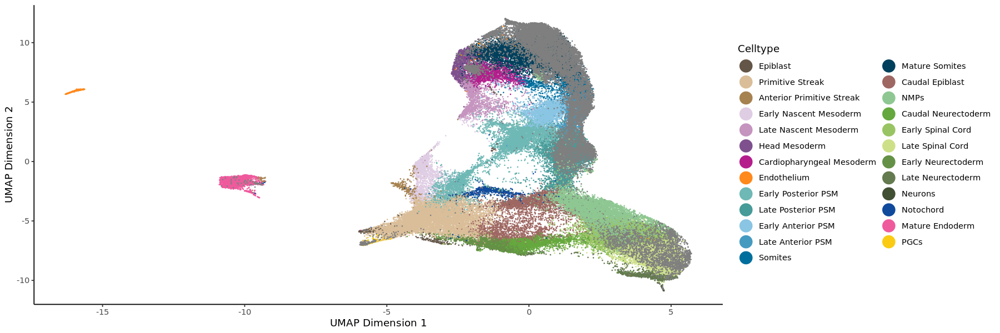

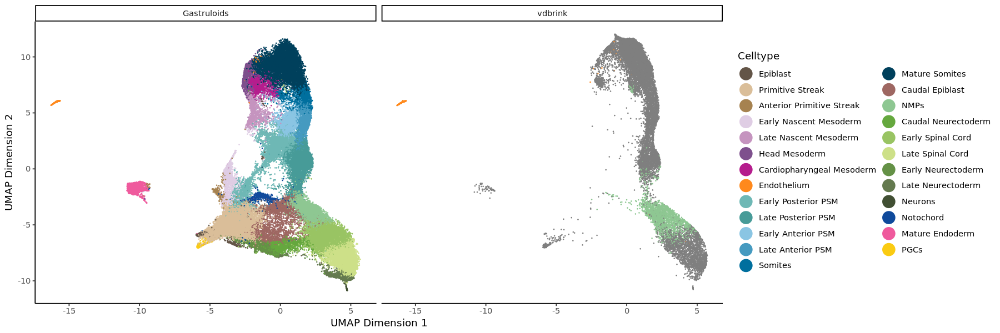

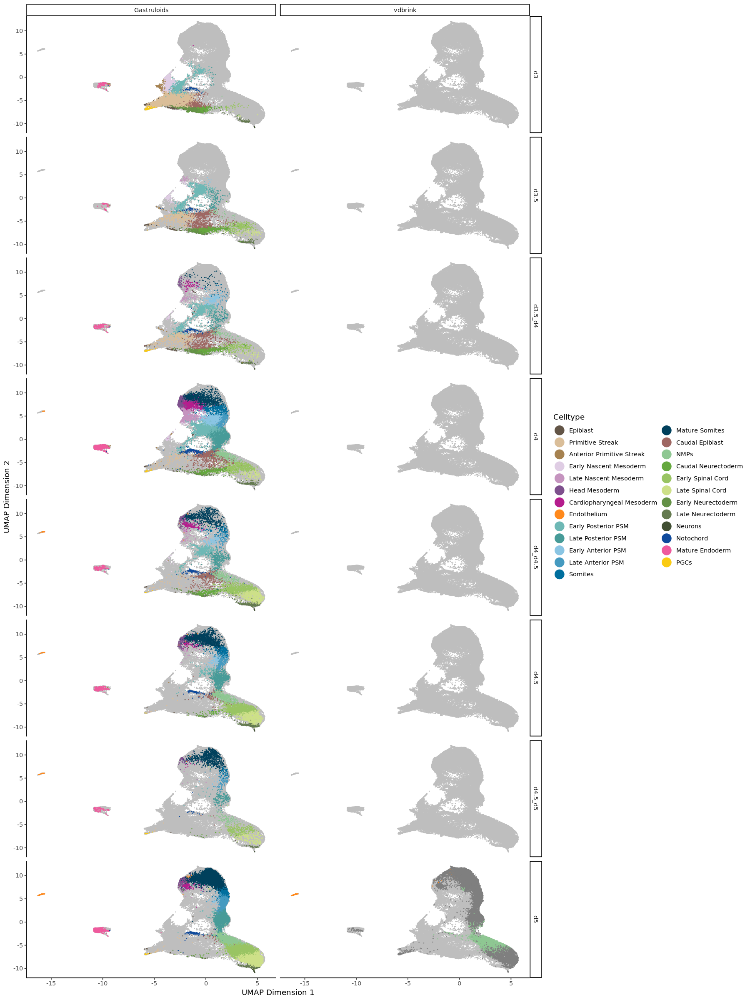

In [24]:
to.plot <- as.data.table(srat_merge@meta.data)

options(repr.plot.width=15, repr.plot.height=5)
p <- ggplot(data=to.plot, mapping = aes(x=X1_vdbrinkInt, y=X2_vdbrinkInt, colour=cluster)) +
  geom_point(size=0.1, alpha=1) +
  # ggrastr::geom_point_rast(size=io$dot_size, alpha=io$dot_alpha) +
  labs(x="UMAP Dimension 1", y="UMAP Dimension 2") +
  scale_colour_manual(values = cluster_colours, name = "Celltype") +
  guides(colour = guide_legend(override.aes = list(size=6))) +
  theme_classic()
print(p)
p <- ggplot(data=to.plot, mapping = aes(x=X1_vdbrinkInt, y=X2_vdbrinkInt, colour=cluster)) +
  geom_point(size=0.1, alpha=1) +
  # ggrastr::geom_point_rast(size=io$dot_size, alpha=io$dot_alpha) +
  labs(x="UMAP Dimension 1", y="UMAP Dimension 2") +
  scale_colour_manual(values = cluster_colours, name = "Celltype") +
  guides(colour = guide_legend(override.aes = list(size=6))) +
  theme_classic() +
  facet_wrap(~dataset)
print(p)

options(repr.plot.width=15, repr.plot.height=20)
#to.plot <- as.data.table(srat@meta.data)
p <- ggplot(data=to.plot[timepoint %in% timepoint_order], mapping = aes(x=X1_vdbrinkInt, y=X2_vdbrinkInt, colour=cluster)) +
  geom_point(data=select(to.plot,-c(timepoint, dataset)), colour="grey", size=0.1, alpha=1) +
  geom_point(size=0.1, alpha=1) +
  # ggrastr::geom_point_rast(size=opts$dot_size, alpha=opts$dot_alpha) +
  labs(x="UMAP Dimension 1", y="UMAP Dimension 2") +
  scale_colour_manual(values = cluster_colours, name = "Celltype") +
  guides(colour = guide_legend(override.aes = list(size=6))) +
  theme_classic() +
  facet_grid(timepoint ~ dataset)
print(p)

In [25]:
saveRDS(srat_merge, "/nfs/research/marioni/Leah/gastrulation_epigenetics/gastruloid_characterisation/data_dir/processed_files_Leah/scRNAseq/seurat_vdbrink_merge.rds")

In [26]:
cluster_order <- c("Allantois", "Mesenchyme", "PGCs", "PGCL", "Epiblast", "Primitive Streak", "Anterior Primitive Streak",
                   "Mature Endoderm", "Endoderm", "Notochord",
                   "Early Nascent Mesoderm", "Late Nascent Mesoderm", "Head Mesoderm", "Paraxial MD", "Cardiopharyngeal Mesoderm", "Cardiac", "Endothelium",
                   "Early Posterior PSM", "Late Posterior PSM", "PSM", "Early Anterior PSM", "Late Anterior PSM", "Differentiation front", "Somites", "Somite", "Mature Somites", "Differentiated somite",
                   "Caudal Epiblast", "NMPs", "Caudal Neurectoderm", "Early Neurectoderm", "Late Neurectoderm", "Early Spinal Cord", "Late Spinal Cord", "Spinal cord", "Neurons"
                  )

In [27]:
cluster_colours = c(
    "PGCL" = "#FACB12",
    "Endoderm" = "#EF5A9D",
    "Spinal cord" = "#CDE088",
    "NMPs" = "#8EC792",
    "PSM" = "#479b98",
    "Somite" = "#006f9e",
    "Differentiated somite" = "#00405c",
    "Differentiation front" = "#8DB5CE",
    "Allantois" = "#532C8A",
    "Mesenchyme" = "#cc7818",
    "Paraxial MD" = "#8DB5CE",
    "Cardiac" = "#B51D8D",
    
    "Epiblast" = "#635547",
    "Primitive Streak" = "#DABE99",
    "Anterior Primitive Streak" = "#a68250",
    "Early Nascent Mesoderm" = "#DFCDE4",
    "Late Nascent Mesoderm" = "#C594BF",
    "Head Mesoderm" = "#7E508D",
    "Cardiopharyngeal Mesoderm" = "#B51D8D",
    "Endothelium" = "#ff891c",
    "Early Posterior PSM" = "#6eb8b5",
    "Late Posterior PSM" = "#479b98",
    "Early Anterior PSM" = "#8ac5e3",
    "Late Anterior PSM" = "#459AC0",
    "Somites" = "#006f9e",
    #"Somites" = "#00405c",
    "Mature Somites" = "#00405c",
    #"Mature Somites" = "#00BFC4",
    "Caudal Epiblast" = "#9E6762",
    "NMPs" = "#8EC792",
    "Caudal Neurectoderm" = "#65A83E",
    "Early Spinal Cord" = "#99C463",
    "Late Spinal Cord" = "#CDE088",
    "Early Neurectoderm" = "#649146",
    "Late Neurectoderm" = "#647a4f",
    "Neurons" = "#414f33",
    "Notochord" = "#0F4A9C",
    "Mature Endoderm" = "#EF5A9D",
    "PGCs" = "#FACB12"
)

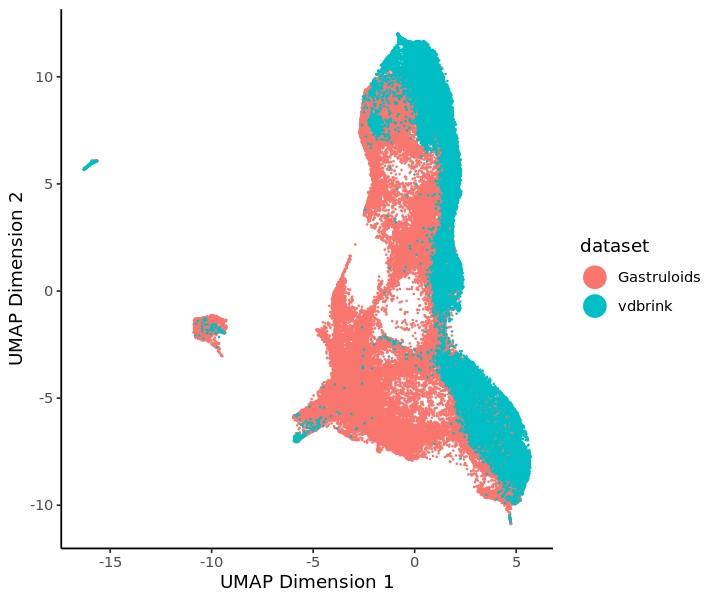

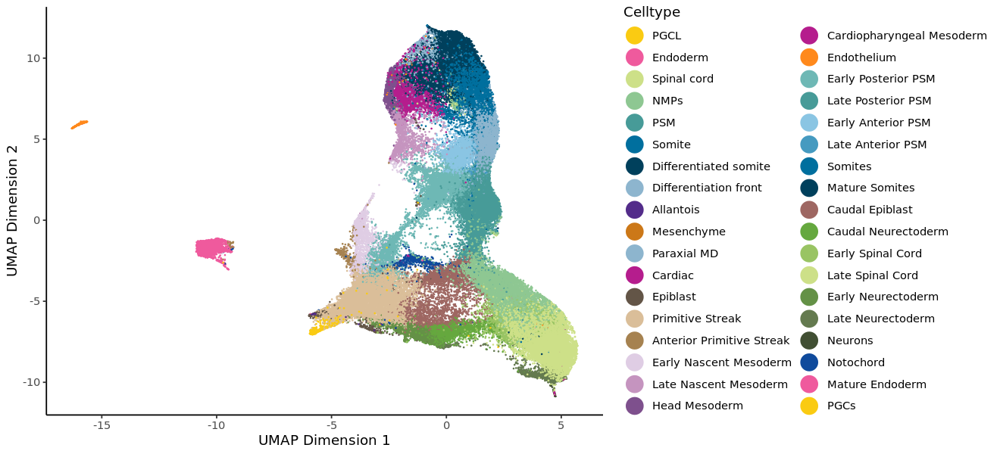

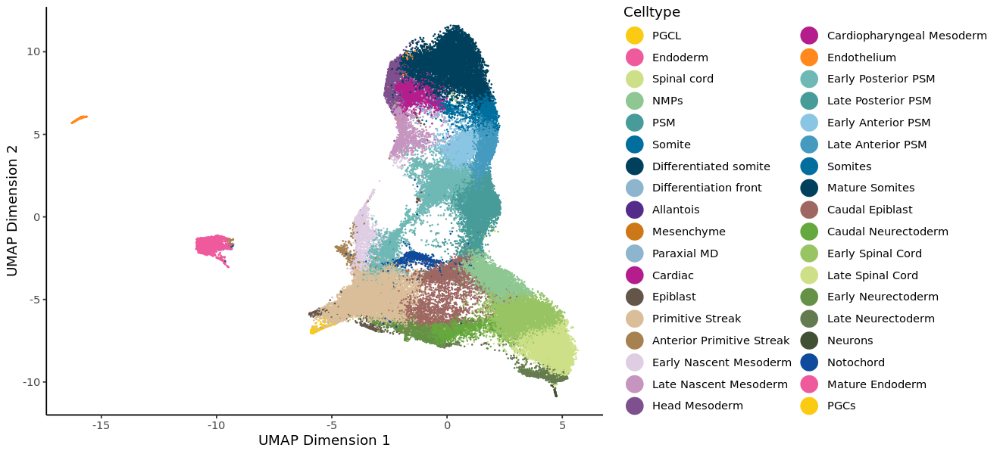

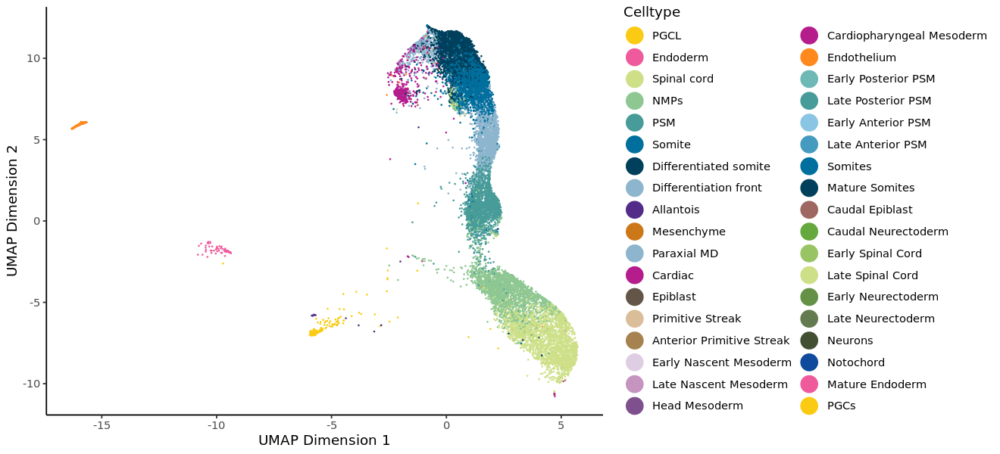

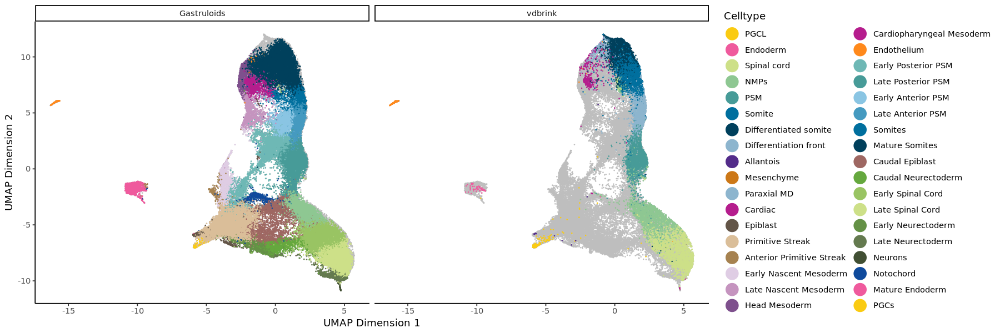

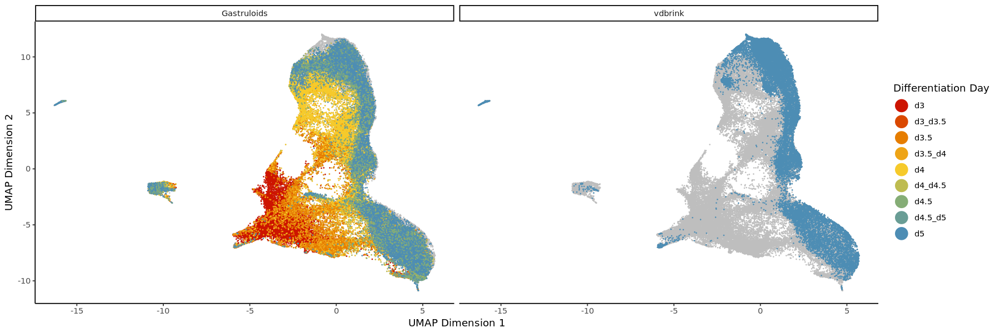

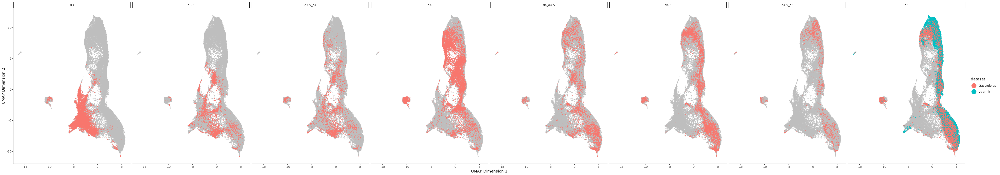

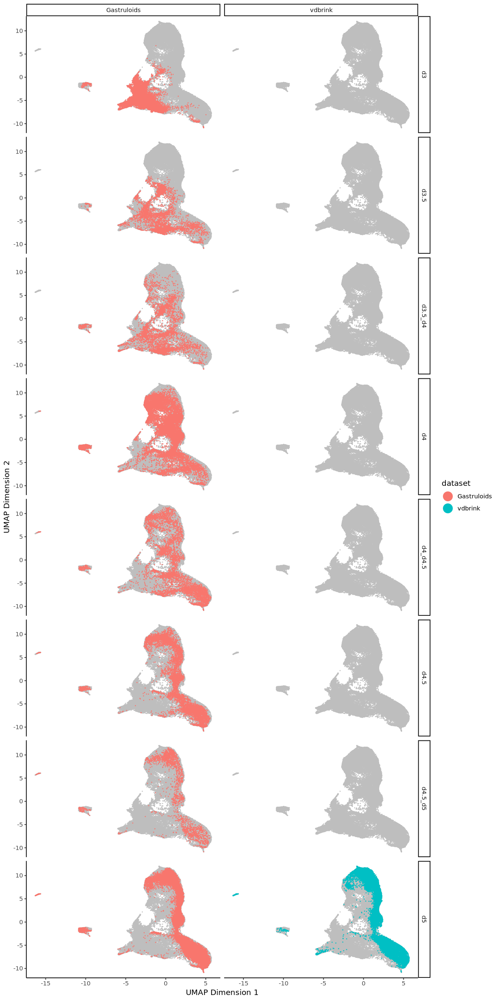

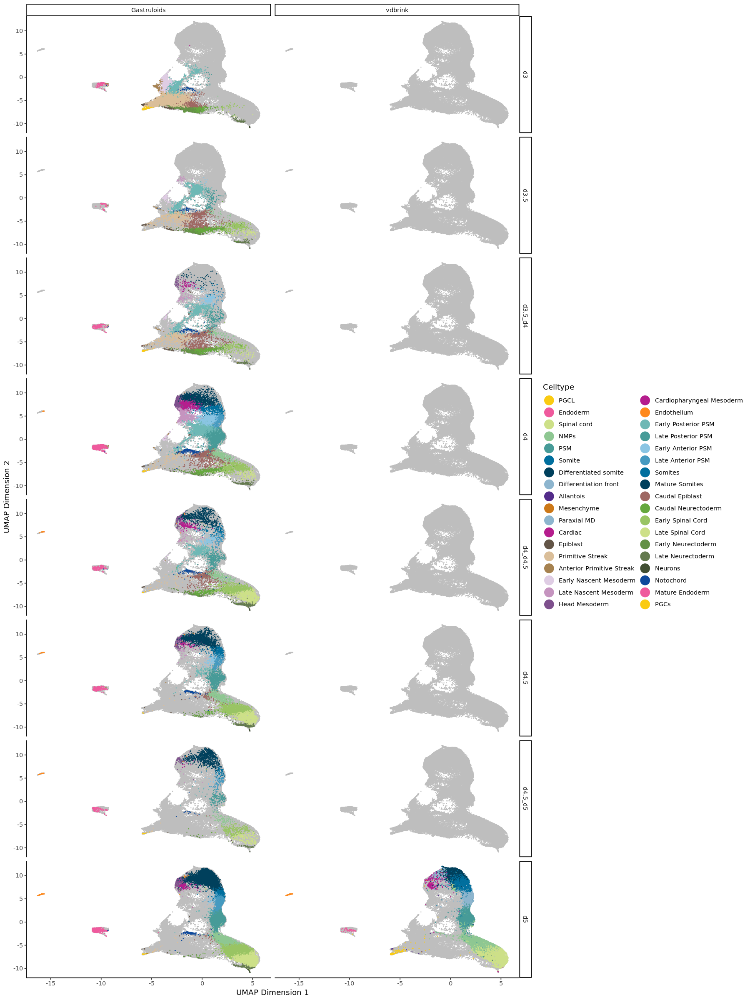

In [28]:
to.plot <- as.data.table(srat_merge@meta.data)

options(repr.plot.width=6, repr.plot.height=5)
p <- ggplot(data=to.plot, mapping = aes(x=X1_vdbrinkInt, y=X2_vdbrinkInt, colour=dataset)) +
  geom_point(size=0.1, alpha=1) +
  # ggrastr::geom_point_rast(size=io$dot_size, alpha=io$dot_alpha) +
  labs(x="UMAP Dimension 1", y="UMAP Dimension 2") +
  guides(colour = guide_legend(override.aes = list(size=6))) +
  theme_classic()
print(p)

options(repr.plot.width=11, repr.plot.height=5)
p <- ggplot(data=to.plot, mapping = aes(x=X1_vdbrinkInt, y=X2_vdbrinkInt, colour=cluster)) +
  geom_point(size=0.1, alpha=1) +
  # ggrastr::geom_point_rast(size=io$dot_size, alpha=io$dot_alpha) +
  labs(x="UMAP Dimension 1", y="UMAP Dimension 2") +
  scale_colour_manual(values = cluster_colours, name = "Celltype") +
  guides(colour = guide_legend(override.aes = list(size=6))) +
  theme_classic()
print(p)

p <- ggplot(data=to.plot[dataset=='Gastruloids'], mapping = aes(x=X1_vdbrinkInt, y=X2_vdbrinkInt, colour=celltype_merge)) +
  geom_point(size=0.1, alpha=1) +
  # ggrastr::geom_point_rast(size=io$dot_size, alpha=io$dot_alpha) +
  labs(x="UMAP Dimension 1", y="UMAP Dimension 2") +
  scale_colour_manual(values = cluster_colours, name = "Celltype") +
  guides(colour = guide_legend(override.aes = list(size=6))) +
  theme_classic()
print(p)

p <- ggplot(data=to.plot[dataset=='vdbrink'], mapping = aes(x=X1_vdbrinkInt, y=X2_vdbrinkInt, colour=celltype_merge)) +
  geom_point(size=0.1, alpha=1) +
  # ggrastr::geom_point_rast(size=io$dot_size, alpha=io$dot_alpha) +
  labs(x="UMAP Dimension 1", y="UMAP Dimension 2") +
  scale_colour_manual(values = cluster_colours, name = "Celltype") +
  guides(colour = guide_legend(override.aes = list(size=6))) +
  theme_classic()
print(p)

options(repr.plot.width=15, repr.plot.height=5)
p <- ggplot(data=to.plot, mapping = aes(x=X1_vdbrinkInt, y=X2_vdbrinkInt, colour=celltype_merge)) +
  geom_point(data=select(to.plot,-dataset), colour="grey", size=0.1, alpha=1) +
  geom_point(size=0.1, alpha=1) +
  # ggrastr::geom_point_rast(size=opts$dot_size, alpha=opts$dot_alpha) +
  labs(x="UMAP Dimension 1", y="UMAP Dimension 2") +
  scale_colour_manual(values = cluster_colours, name = "Celltype") +
  guides(colour = guide_legend(override.aes = list(size=6))) +
  theme_classic() +
  facet_wrap(~ dataset, nrow=1)
print(p)

options(repr.plot.width=15, repr.plot.height=5)
p <- ggplot(data=to.plot, mapping = aes(x=X1_vdbrinkInt, y=X2_vdbrinkInt, colour=timepoint)) +
  geom_point(data=select(to.plot,-dataset), colour="grey", size=0.1, alpha=1) +
  geom_point(size=0.1, alpha=1) +
  # ggrastr::geom_point_rast(size=opts$dot_size, alpha=opts$dot_alpha) +
  labs(x="UMAP Dimension 1", y="UMAP Dimension 2") +
  scale_colour_manual(values = timepoint_colours, name = "Differentiation Day") +
  guides(colour = guide_legend(override.aes = list(size=6))) +
  theme_classic() +
  facet_wrap(~ dataset, nrow=1)
print(p)

options(repr.plot.width=40, repr.plot.height=7)
to.plot_shuffle <- to.plot[sample(nrow(to.plot)),]
to.plot_shuffle$timepoint <- factor(to.plot_shuffle$timepoint, levels=timepoint_order)
p <- ggplot(data=to.plot_shuffle[timepoint %in% timepoint_order], mapping = aes(x=X1_vdbrinkInt, y=X2_vdbrinkInt, colour=dataset)) +
  geom_point(data=select(to.plot_shuffle,-timepoint), colour="grey", size=0.1, alpha=1) +
  geom_point(size=0.1, alpha=1) +
  # ggrastr::geom_point_rast(size=opts$dot_size, alpha=opts$dot_alpha) +
  labs(x="UMAP Dimension 1", y="UMAP Dimension 2") +
  guides(colour = guide_legend(override.aes = list(size=6))) +
  theme_classic() +
  facet_wrap(~ timepoint, nrow=1)
print(p)


options(repr.plot.width=10, repr.plot.height=20)
#to.plot <- as.data.table(srat@meta.data)
p <- ggplot(data=to.plot[timepoint %in% timepoint_order], mapping = aes(x=X1_vdbrinkInt, y=X2_vdbrinkInt, colour=dataset)) +
  geom_point(data=select(to.plot,-c(timepoint, dataset)), colour="grey", size=0.1, alpha=1) +
  geom_point(size=0.1, alpha=1) +
  # ggrastr::geom_point_rast(size=opts$dot_size, alpha=opts$dot_alpha) +
  labs(x="UMAP Dimension 1", y="UMAP Dimension 2") +
  guides(colour = guide_legend(override.aes = list(size=6))) +
  theme_classic() +
  facet_grid(timepoint ~ dataset)
print(p)

options(repr.plot.width=15, repr.plot.height=20)
#to.plot <- as.data.table(srat@meta.data)
p <- ggplot(data=to.plot[timepoint %in% timepoint_order], mapping = aes(x=X1_vdbrinkInt, y=X2_vdbrinkInt, colour=cluster)) +
  geom_point(data=select(to.plot,-c(timepoint, dataset)), colour="grey", size=0.1, alpha=1) +
  geom_point(size=0.1, alpha=1) +
  # ggrastr::geom_point_rast(size=opts$dot_size, alpha=opts$dot_alpha) +
  labs(x="UMAP Dimension 1", y="UMAP Dimension 2") +
  scale_colour_manual(values = cluster_colours, name = "Celltype") +
  guides(colour = guide_legend(override.aes = list(size=6))) +
  theme_classic() +
  facet_grid(timepoint ~ dataset)
print(p)

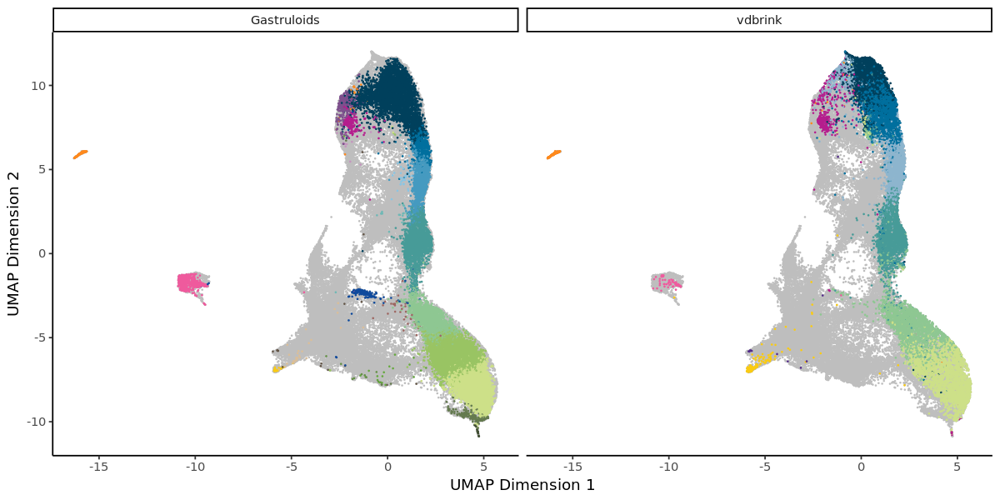

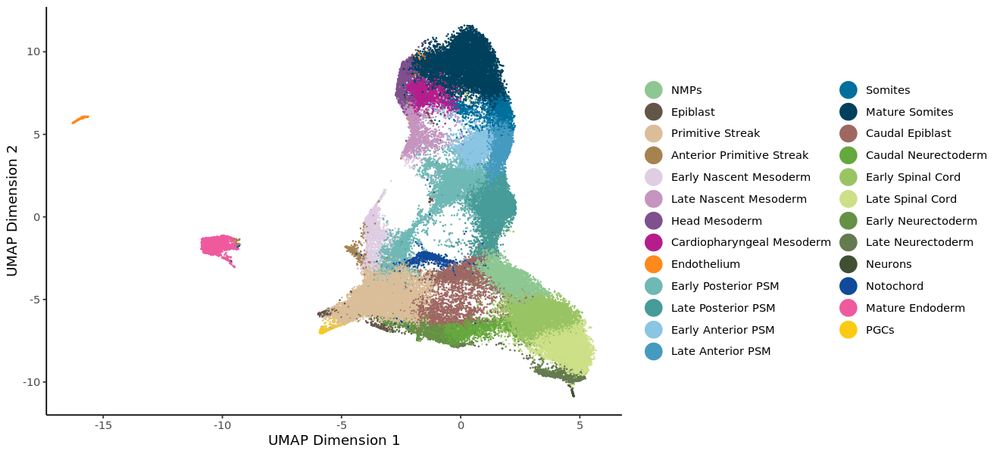

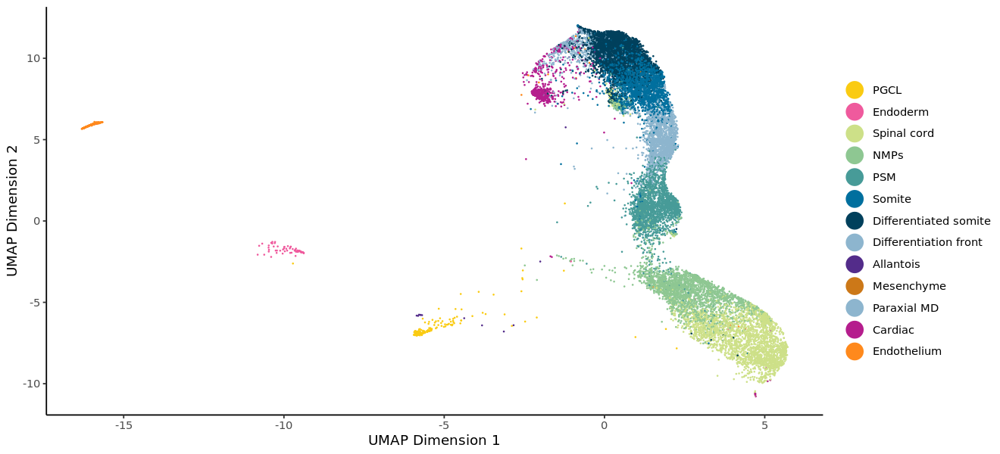

In [29]:
options(repr.plot.width=10, repr.plot.height=5)
to.plot <- as.data.table(srat_merge@meta.data)
p <- ggplot(data=to.plot[timepoint == 'd5'], mapping = aes(x=X1_vdbrinkInt, y=X2_vdbrinkInt, colour=cluster)) +
  geom_point(data=select(to.plot,-c(timepoint, dataset)), colour="grey", size=0.1, alpha=1) +
  geom_point(size=0.1, alpha=1) +
  # ggrastr::geom_point_rast(size=opts$dot_size, alpha=opts$dot_alpha) +
  labs(x="UMAP Dimension 1", y="UMAP Dimension 2") +
  scale_colour_manual(values = cluster_colours, name = "Celltype") +
  theme_classic() +
  theme(legend.position="None") +
  facet_wrap( ~ dataset, nrow=1)
print(p)
ggsave(
  '/nfs/research/marioni/Leah/gastrulation_epigenetics/gastruloid_characterisation/data_dir/processed_files_Leah/scRNAseq/final_plots/SuppFig2/A.pdf',
  plot = p,
  device = 'pdf',
  width = 10,
  height = 5,
  units = "in"
)

options(repr.plot.width=11, repr.plot.height=5)

p <- ggplot(data=to.plot[dataset=='Gastruloids'], mapping = aes(x=X1_vdbrinkInt, y=X2_vdbrinkInt, colour=celltype_merge)) +
  geom_point(size=0.1, alpha=1) +
  # ggrastr::geom_point_rast(size=io$dot_size, alpha=io$dot_alpha) +
  labs(x="UMAP Dimension 1", y="UMAP Dimension 2") +
  scale_colour_manual(values = cluster_colours[names(cluster_colours) %in% to.plot[dataset=='Gastruloids']$cluster],
                      name = ""
                     ) +
  guides(colour = guide_legend(override.aes = list(size=6))) +
  theme_classic()
print(p)
ggsave(
  '/nfs/research/marioni/Leah/gastrulation_epigenetics/gastruloid_characterisation/data_dir/processed_files_Leah/scRNAseq/final_plots/SuppFig2/A_leg1.pdf',
  plot = p,
  device = 'pdf',
  width = 11,
  height = 5,
  units = "in"
)

p <- ggplot(data=to.plot[dataset=='vdbrink'], mapping = aes(x=X1_vdbrinkInt, y=X2_vdbrinkInt, colour=celltype_merge)) +
  geom_point(size=0.1, alpha=1) +
  # ggrastr::geom_point_rast(size=io$dot_size, alpha=io$dot_alpha) +
  labs(x="UMAP Dimension 1", y="UMAP Dimension 2") +
  scale_colour_manual(values = cluster_colours[names(cluster_colours) %in% to.plot[dataset=='vdbrink']$cluster],
                      name = ""
                     ) +
  guides(colour = guide_legend(override.aes = list(size=6))) +
  theme_classic()
print(p)
ggsave(
  '/nfs/research/marioni/Leah/gastrulation_epigenetics/gastruloid_characterisation/data_dir/processed_files_Leah/scRNAseq/final_plots/SuppFig2/A_leg2.pdf',
  plot = p,
  device = 'pdf',
  width = 11,
  height = 5,
  units = "in"
)

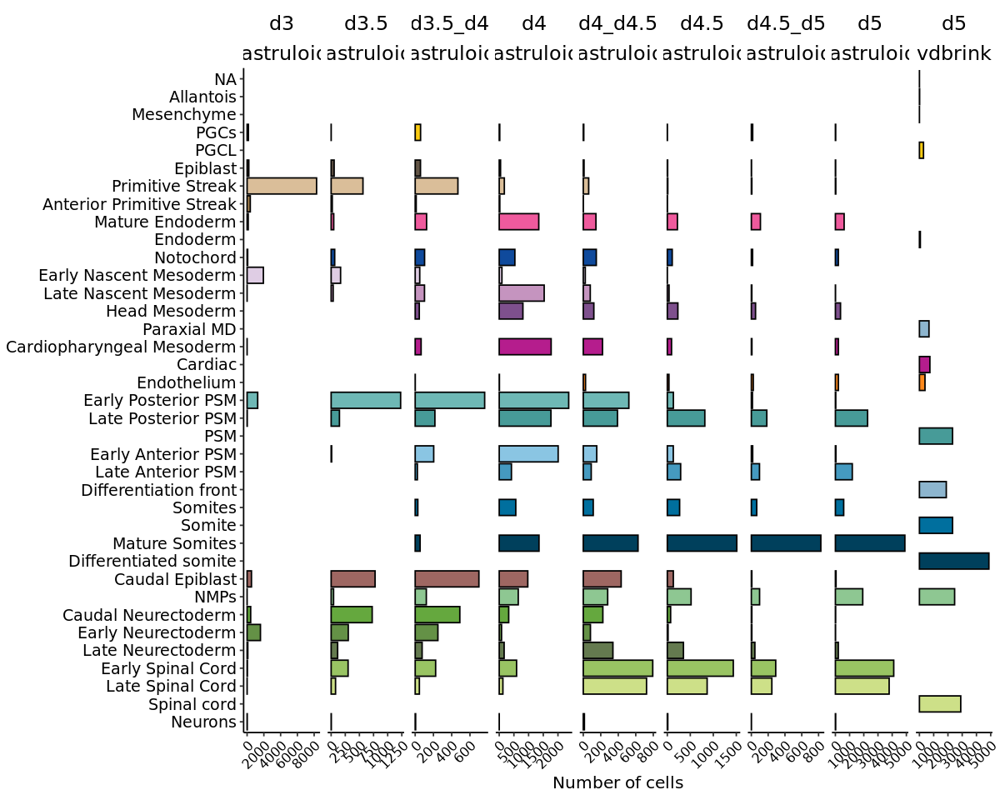

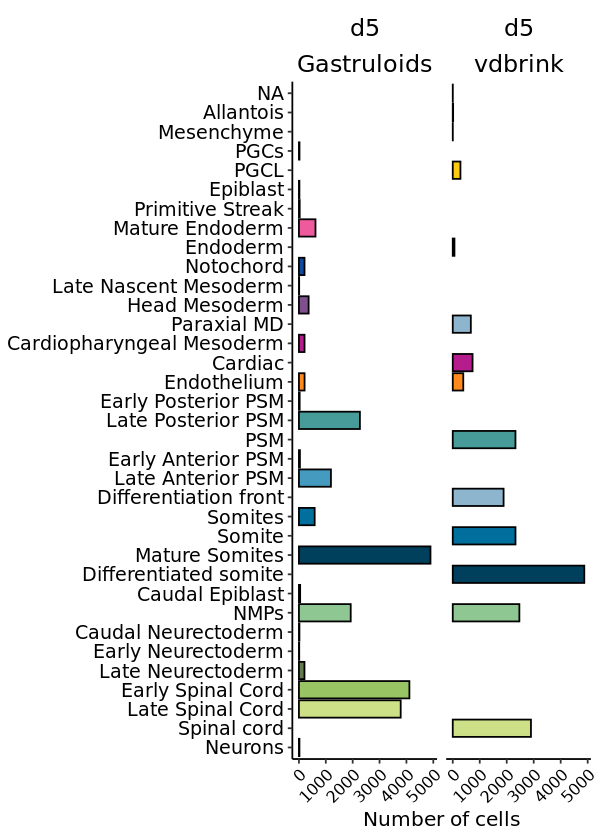

In [30]:
barplot.pub <- function(to.plot, x="cluster", colors=NULL, xlim.max=NULL, y="N") {
  p <- ggplot(to.plot, aes_string(x=x, y=y)) +
    scale_x_discrete(drop=FALSE) + 
    # coord_flip() +
    labs(y="Number of cells") +
    theme_classic() +
    theme(
      legend.position = "none",
      strip.background = element_blank(),
      strip.text = element_text(color="black", size=rel(1.3)),
      axis.title.x = element_text(color="black", size=rel(1.1)),
      axis.title.y = element_blank(),
      axis.text.y = element_text(size=rel(1.3), color="black"),
      axis.text.x = element_text(size=rel(1.1), color="black")
    )
    
    #if (is.null(colors)) {
    #    p <- p + geom_bar(stat="identity", color="black")
    #}
    if (is.null(colors)) {
        p <- p + geom_bar(stat="identity", aes_string(fill=x))
    } else {
        p <- p + geom_bar(aes_string(fill=x), stat="identity", color="black") + 
            scale_fill_manual(values=colors, drop=F)
    }

    if (!is.null(xlim.max)) {
      p <- p + coord_flip(ylim=c(0,xlim.max))
    } else {
      p <- p + coord_flip()
    }
  
    return(p)
}

options(repr.plot.width=10, repr.plot.height=8)
to.plot <- as.data.table(srat_merge@meta.data)[(timepoint %in% timepoint_order)][,.N,by=c("cluster","timepoint", "dataset")]
to.plot$timepoint <- factor(to.plot$timepoint, levels = timepoint_order)
to.plot$cluster <- factor(to.plot$cluster, levels = rev(cluster_order))
celltypes_mapped <- barplot.pub(to.plot, x="cluster", colors=cluster_colours) +
  facet_wrap(~timepoint + dataset, nrow=1, scales="free_x") +
  theme(axis.text.x = element_text(angle = 45, vjust = 1, hjust=1))
print(celltypes_mapped)

options(repr.plot.width=5, repr.plot.height=7)
to.plot <- as.data.table(srat_merge@meta.data)[(timepoint == 'd5')][,.N,by=c("cluster","timepoint", "dataset")]
to.plot$timepoint <- factor(to.plot$timepoint, levels = timepoint_order)
to.plot$cluster <- factor(to.plot$cluster, levels = rev(cluster_order[cluster_order %in% unique(to.plot$cluster)]))
p <- barplot.pub(to.plot, x="cluster", colors=cluster_colours[names(cluster_colours) %in% unique(to.plot$cluster)]) +
  facet_wrap(~timepoint + dataset, nrow=1, scales="free_x") +
  theme(axis.text.x = element_text(angle = 45, vjust = 1, hjust=1))
print(p)
ggsave(
  '/nfs/research/marioni/Leah/gastrulation_epigenetics/gastruloid_characterisation/data_dir/processed_files_Leah/scRNAseq/final_plots/SuppFig2/B.pdf',
  plot = p,
  device = 'pdf',
  width = 5,
  height = 7,
  units = "in"
)

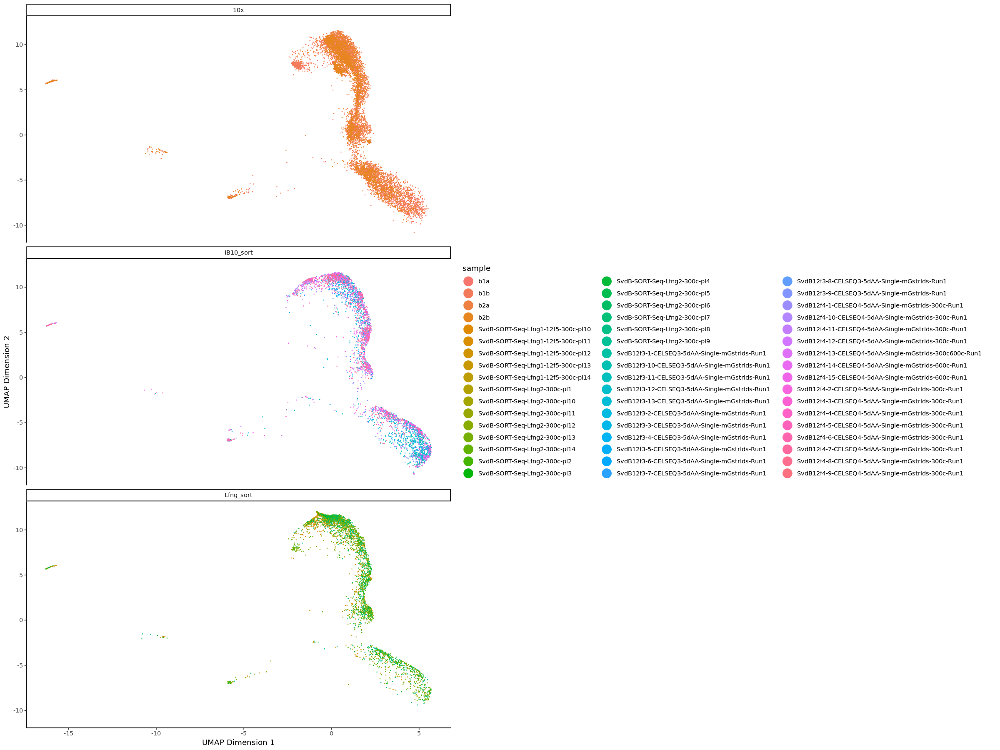

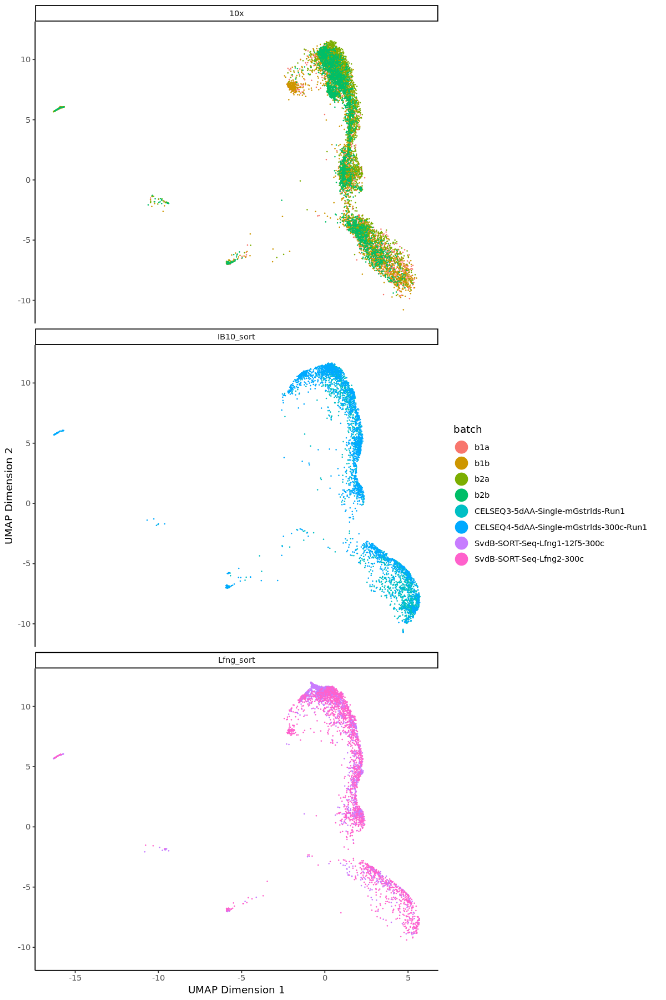

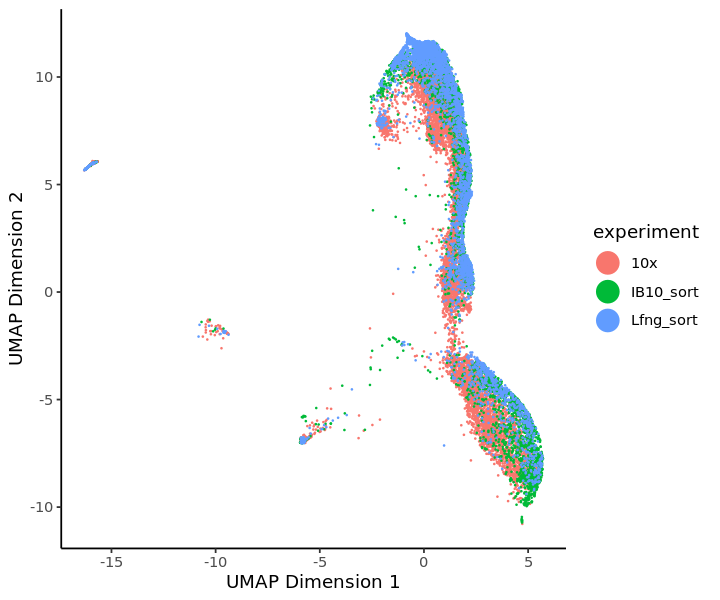

In [31]:
options(repr.plot.width=20, repr.plot.height=15)
to.plot <- as.data.table(srat_merge@meta.data)
p <- ggplot(data=to.plot[dataset=='vdbrink'], mapping = aes(x=X1_vdbrinkInt, y=X2_vdbrinkInt, colour=sample)) +
  geom_point(size=0.1, alpha=1) +
  # ggrastr::geom_point_rast(size=io$dot_size, alpha=io$dot_alpha) +
  labs(x="UMAP Dimension 1", y="UMAP Dimension 2") +
  guides(colour = guide_legend(override.aes = list(size=6))) +
  theme_classic() + facet_wrap(~experiment, nrow=3)
print(p)
options(repr.plot.width=10, repr.plot.height=15)
p <- ggplot(data=to.plot[dataset=='vdbrink'], mapping = aes(x=X1_vdbrinkInt, y=X2_vdbrinkInt, colour=batch)) +
  geom_point(size=0.1, alpha=1) +
  # ggrastr::geom_point_rast(size=io$dot_size, alpha=io$dot_alpha) +
  labs(x="UMAP Dimension 1", y="UMAP Dimension 2") +
  guides(colour = guide_legend(override.aes = list(size=6))) +
  theme_classic() + facet_wrap(~experiment, nrow=3)
print(p)
options(repr.plot.width=6, repr.plot.height=5)
p <- ggplot(data=to.plot[dataset=='vdbrink'], mapping = aes(x=X1_vdbrinkInt, y=X2_vdbrinkInt, colour=experiment)) +
  geom_point(size=0.1, alpha=1) +
  # ggrastr::geom_point_rast(size=io$dot_size, alpha=io$dot_alpha) +
  labs(x="UMAP Dimension 1", y="UMAP Dimension 2") +
  guides(colour = guide_legend(override.aes = list(size=6))) +
  theme_classic()
print(p)

In [32]:
library(Matrix.utils)

Loading required package: Matrix


Attaching package: ‘Matrix’


The following object is masked from ‘package:S4Vectors’:

    expand




In [33]:
srat_merge_d5 <- subset(srat_merge, subset = timepoint=="d5")
srat_merge_d5 <- FindNeighbors(srat_merge_d5, k.param=30, reduction = "pca")

Computing nearest neighbor graph

Computing SNN



In [34]:
nns_exp <- aggregate.Matrix(t(srat_merge_d5@graphs$RNA_nn), groupings=srat_merge_d5@meta.data$experiment) %>% t %>% as.matrix
nns_exp <- sapply(colnames(nns_exp), function(c) nns_exp[,c]/sum(srat_merge_d5@meta.data$experiment==c))
nns_exp <- nns_exp/rowSums(nns_exp)
nns_exp <- as.data.frame(nns_exp)
nns_exp$cell <- rownames(nns_exp)
nns_exp <- melt(nns_exp, id.vars = "cell")
nns_exp <- merge(nns_exp, srat_merge_d5@meta.data, by="cell", all.x=TRUE) %>% as.data.table

nns_exp[experiment == '10x', experiment := 'vdBrink, 10X']
nns_exp[variable == '10x', variable := 'vdBrink, 10X']
nns_exp[experiment == 'exp1_d5', experiment := 'exp1, 10X']
nns_exp[variable == 'exp1_d5', variable := 'exp1, 10X']
nns_exp[experiment == 'exp6_d4.5_d5', experiment := 'exp6, 10X']
nns_exp[variable == 'exp6_d4.5_d5', variable := 'exp6, 10X']
nns_exp[experiment == 'IB10_sort', experiment := 'vdBrink, IB10 CELseq']
nns_exp[variable == 'IB10_sort', variable := 'vdBrink, IB10 CELseq']
nns_exp[experiment == 'Lfng_sort', experiment := 'vdBrink, Lfng CELseq']
nns_exp[variable == 'Lfng_sort', variable := 'vdBrink, Lfng CELseq']

Warning message in melt(nns_exp, id.vars = "cell"):
“The melt generic in data.table has been passed a data.frame and will attempt to redirect to the relevant reshape2 method; please note that reshape2 is deprecated, and this redirection is now deprecated as well. To continue using melt methods from reshape2 while both libraries are attached, e.g. melt.list, you can prepend the namespace like reshape2::melt(nns_exp). In the next version, this warning will become an error.”


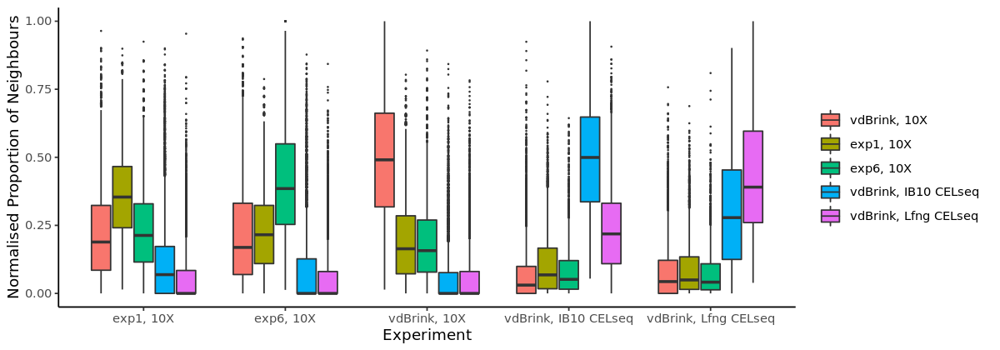

In [35]:
options(repr.plot.width=10, repr.plot.height=3.5)
p <- ggplot(nns_exp, aes(x=experiment, y=value, fill=variable)) +
  geom_boxplot(outlier.size = 0.1) +
  labs(x="Experiment", y="Normalised Proportion of Neighbours", fill="") +
  theme_classic()
print(p)
ggsave(
  '/nfs/research/marioni/Leah/gastrulation_epigenetics/gastruloid_characterisation/data_dir/processed_files_Leah/scRNAseq/final_plots/SuppFig2/C.pdf',
  plot = p,
  device = 'pdf',
  width = 10,
  height = 3.5,
  units = "in"
)


In [36]:
tmp <- as.data.table(nns_exp)[,c("variable", "experiment", "value")]
tmp[, value := mean(value), by=c("variable", "experiment")]
tmp <- unique(tmp)


Attaching package: ‘scales’


The following object is masked from ‘package:viridis’:

    viridis_pal


The following object is masked from ‘package:purrr’:

    discard




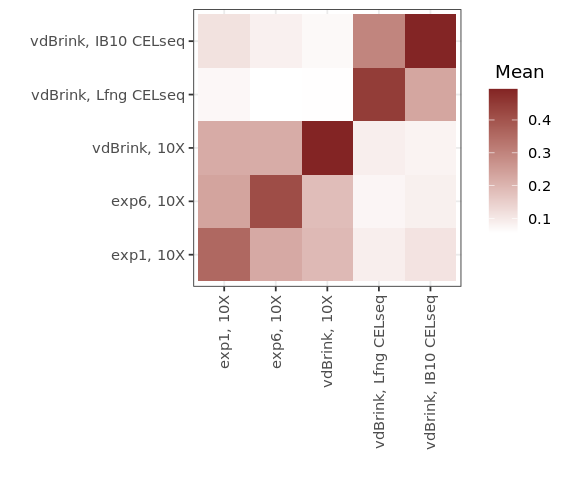

In [37]:
library(colorspace)
library(scales)
options(repr.plot.width=4.75, repr.plot.height=4)
tmp$experiment <- factor(tmp$experiment, levels=c("exp1, 10X", "exp6, 10X", "vdBrink, 10X", "vdBrink, Lfng CELseq", "vdBrink, IB10 CELseq"))
tmp$variable <- factor(tmp$variable, levels=c("exp1, 10X", "exp6, 10X", "vdBrink, 10X", "vdBrink, Lfng CELseq", "vdBrink, IB10 CELseq"))
p <- ggplot(data=tmp, mapping = aes(x=experiment, y=variable, fill=value)) +
  geom_tile() +
  # ggrastr::geom_point_rast(size=opts$dot_size, alpha=opts$dot_alpha) +
  #scale_fill_continuous_divergingx(palette = "RdBu", mid = 0, rev=TRUE, name="") +
  scale_fill_gradient(low="white", high=muted("red")) +
  labs(x="", y="", fill="Mean") +
  theme_bw() +
  #theme(axis.text.x = element_text(angle = 90, vjust = 0.5, hjust=1, colour=cluster_colours))
  theme(axis.text.x = element_text(angle = 90, vjust = 0.5, hjust=1)) +
  guides(fill = guide_colourbar(title.position="top", title.hjust = 0.5),
         size = guide_legend(title.position="top", title.hjust = 0.5))
print(p)
ggsave(
  '/nfs/research/marioni/Leah/gastrulation_epigenetics/gastruloid_characterisation/data_dir/processed_files_Leah/scRNAseq/final_plots/SuppFig2/D.pdf',
  plot = p,
  device = 'pdf',
  width = 4.75,
  height = 4,
  units = "in"
)


In [38]:
table(srat_merge_d5@meta.data$dataset)


Gastruloids     vdbrink 
      20811       18935 